In [30]:
import matplotlib.pyplot as plt
import pickle as pkl
from collections import Counter

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA

from adjustText import adjust_text
import scipy
from scipy.stats import pearsonr

In [24]:
import re
import scipy

In [2]:
bios = pkl.load(open('biosbias/data/BIOS_inferred.pkl','rb'))
data = bios
print(f'Data: {len(data)}')

# stratified split
labels_all = [bio['title'] for bio in data]
bios_data_train_val, bios_data_test = train_test_split(data, test_size=0.20, random_state=42, stratify=labels_all)

labels_train_val = [bio['title'] for bio in bios_data_train_val]
bios_data_train, bios_data_val = train_test_split(bios_data_train_val, test_size=0.25, random_state=42, stratify=labels_train_val)


Data: 397907


In [460]:
np.where(bios_data_train

{'path': 'crawl-data/CC-MAIN-2017-43/segments/1508187823478.54/wet/CC-MAIN-20171019212946-20171019232946-00228.warc.wet.gz',
 'raw': 'Arian S. Elfant, Ph.D. is a Clinical Psychologist who has been in private practice in New Orleans since 2003. Her experience in end-of-life care began when she moved to New Orleans volunteering her clinical services at the Tulane Cancer Center. At the Cancer Center, she saw patients who were in need of therapeutic support and co-led a group for survivors of brain tumors. Dr. Elfant also had the opportunity to facilitate the Schwartz Center Rounds at the Tulane Medical Center. These experiences earned her a faculty appointment at Tulane. In 2015, Dr. Elfant developed and hosted a bimonthly podcast series on the subject of death, airing on itsneworleans.com.',
 'name': ('Arian', 'S', 'Elfant'),
 'raw_title': 'Psychologist',
 'gender': 'F',
 'start_pos': 109,
 'title': 'psychologist',
 'URI': 'http://dmnnewswire.digitalmedianet.com/article/Panel-of-Experts-

In [10]:
with open("../../words/embeddings/OtherFormats/crawl-300d-2M.pkl", "rb") as f:
    E = pkl.load(f)
print("Loaded", len(E), "words")
 
def sim(w1, w2):
    return E[w1].dot(E[w2])/np.linalg.norm(E[w1])/np.linalg.norm(E[w2])
 
sim('he', 'she')

def word_vector_featurize(text, Emb = E):
    return np.mean([Emb[w] for w in re.split(r"[\s\.\!\?\:,\"“\—\-\(\)]+", text) if len(w)>1 and w in Emb], axis=0)


Loaded 1999995 words


In [22]:
def sim_emb(e1, e2):
    return e1.dot(e2)/np.linalg.norm(e1)/np.linalg.norm(e2)
 

# Plots of SNoB in fair classifiers

In [38]:
(joint_corr_full,decoupled_corr_full,tpr_corr_full,pr_corr_full) = pkl.load(open('results/corrs_we.pkl','rb'))

Populating the interactive namespace from numpy and matplotlib


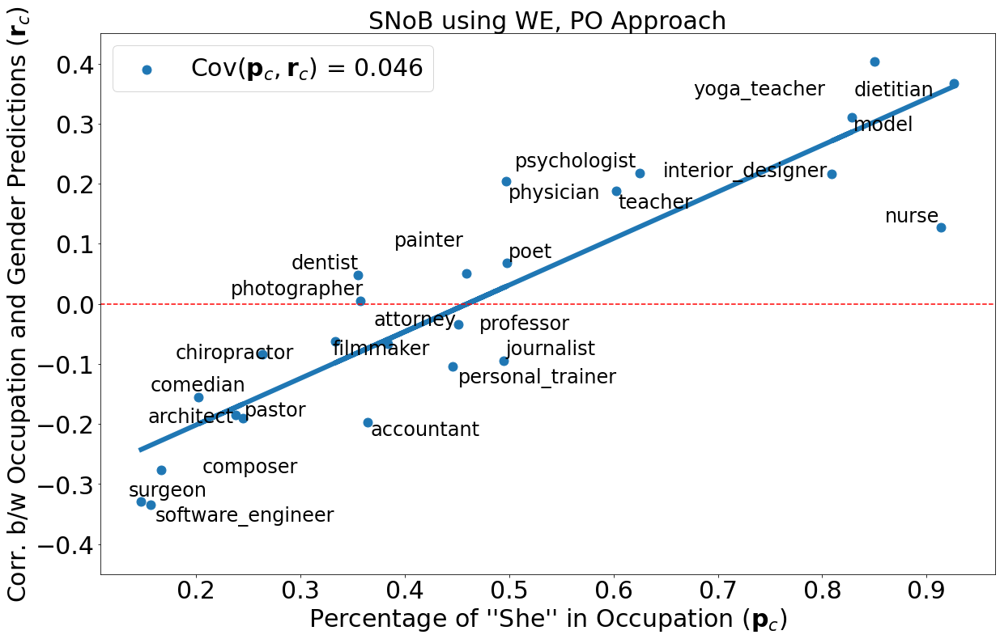

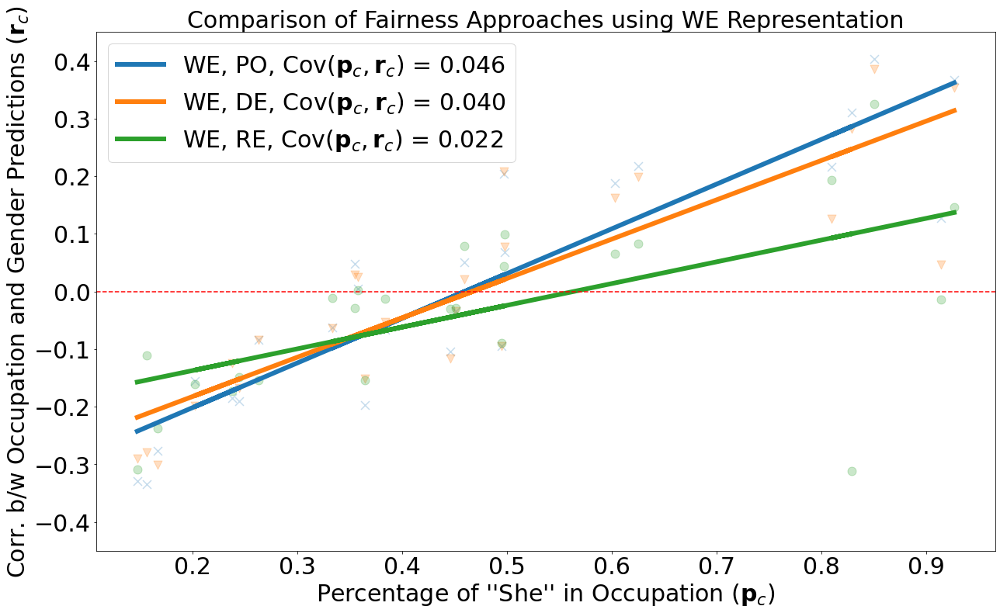

In [39]:
%pylab inline
fontsizeval = 30
from adjustText import adjust_text
import scipy
from scipy.stats import pearsonr
plt.rc('text', usetex=False)

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


f_frac = np.load('results/f_frac.npy')

pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,label='Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,joint_corr_full)[0,1]))
plt.plot(xs, m*xs+ b,linewidth=6)

leg = plt.legend(loc='upper left',fontsize=fontsizeval)

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_c$)"
y_label = r'Corr. b/w Occupation and Gender Predictions ($\mathbf{r}_c$)'
texts = [plt.text(x,y,l,size=24) for x, y, l in zip(f_frac, joint_corr_full, occs)]

xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
plt.ylim([-0.45, 0.45])
plt.title("SNoB using WE, PO Approach",fontsize=fontsizeval)
plt.xticks(fontsize= fontsizeval)

plt.yticks(fontsize= fontsizeval)
plt.tight_layout()
adjust_text(texts)
plt.savefig('fig1_pearson_tight.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)
plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,joint_corr_full)[0,1]))

m, b = np.polyfit(xs, np.array(decoupled_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr_full,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,decoupled_corr_full)[0,1]))


m, b = np.polyfit(xs, np.array(tpr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,tpr_corr_full)[0,1]))
leg = plt.legend(loc='upper left',fontsize= fontsizeval)


plt.axhline(y=0, color='r', linestyle='dashed')

adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
plt.ylim([-0.45, 0.45])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison of Fairness Approaches using WE Representation",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


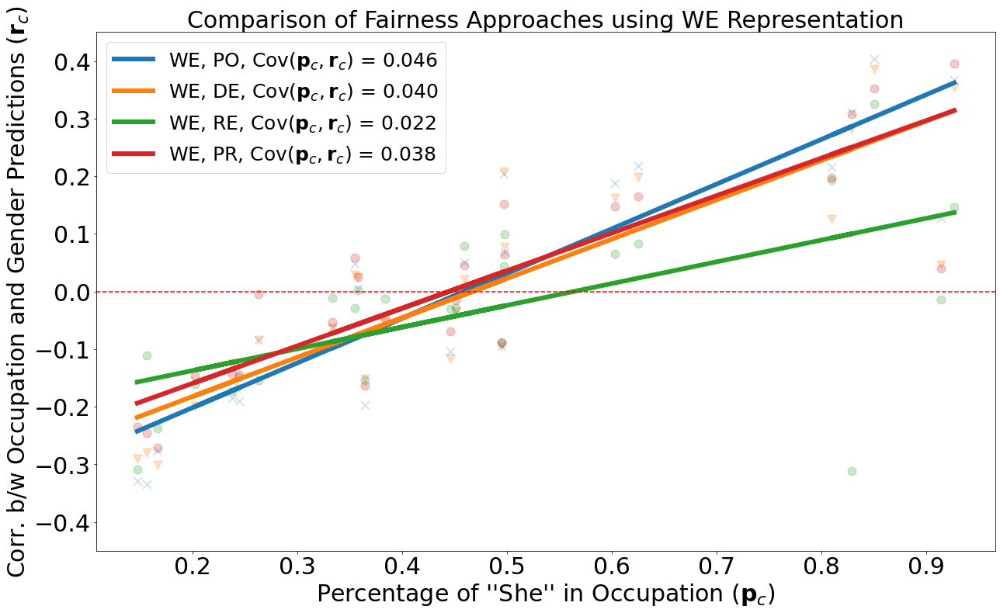

In [186]:

plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_c$)"
y_label = r'Corr. b/w Occupation and Gender Predictions ($\mathbf{r}_c$)'
m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,joint_corr_full)[0,1]))

m, b = np.polyfit(xs, np.array(decoupled_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr_full,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,decoupled_corr_full)[0,1]))


m, b = np.polyfit(xs, np.array(tpr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,tpr_corr_full)[0,1]))


m, b = np.polyfit(xs, np.array(pr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,pr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PR, Cov$(\mathbf{p}_c, \mathbf{r}_c)$ = %.3f'%(np.cov(f_frac,pr_corr_full)[0,1]))

leg = plt.legend(loc='upper left',fontsize= fontsizeval-5)


plt.axhline(y=0, color='r', linestyle='dashed')

# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
plt.ylim([-0.45, 0.45])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison of Fairness Approaches using WE Representation",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight_4.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


# plot gender classifier vs. human-labeled gender scores

In [29]:
# function to systematically plot a subset of the words without overcrowding
def text_plot_words_locs(xs, ys, words, num=5,width = 90, height = 40, filename=None):
    PADDING = 10 # num chars on left and right in case words spill over
    res = [[' ' for i in range(width)] for j in range(height)]
    x_vals = []
    y_vals = []
    kept_words = []
    def rescale(nums):
        a = min(nums)
        b = max(nums)
        return [(x-a)/(b-a) for x in nums]
#     print("x:", (-num,num), "y:",(-num,num))
    xs_r = rescale(xs)
    ys_r = rescale(ys)
    for (x, y, word,ox, oy) in zip(xs_r, ys_r, words,xs,ys):
        i = int(x*(width - 1 - PADDING))
        j = int(y*(height-1 - PADDING))
        row = res[j]
        z = list(row[i2] != ' ' for i2 in range(max(i-1, 0), min(width, i + len(word) + 1)))
        if any(z):
            continue
        for k in range(len(word)):
            if i+k>=width:
                break
            row[i+k] = word[k]
        x_vals.append(ox)
        y_vals.append(oy)
        kept_words.append(word)
    return x_vals, y_vals, kept_words

In [16]:
# load gender classifier
balanced_gender_clf=pkl.load(open('results/we_bal_g.pkl','rb'))


In [20]:
# plot to compare gender classifier words to human-labeled scores for g_irrev
import pandas as pd


gender_words_df = pd.read_csv('csvs/crawford2004.csv')
gender_words = list(gender_words_df['Stimulus Word'])[1:]
gender_nj = list(gender_words_df['NJ mean'])[1:]
corr_rs = []
for target_occ in occs:
    # get word embeddings
    candwordvecs = []
    wordlist = []
    temp_gender_nj = []
    for i,k in enumerate(gender_words):
        temp = word_vector_featurize(k, E)
        # if statement to remove words that do not have embeddings
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
            temp_gender_nj.append(gender_nj[i])

    gender_dots = [sim_emb(chi_gender_classers_or[target_occ][thr].coef_[0],w) for w in candwordvecs] 

    xs = temp_gender_nj
    ys = gender_dots
    labels =wordlist
    m, b = np.polyfit(xs, ys, 1)
    corr_r =  scipy.stats.spearmanr(xs,ys)[0]

#     plt.figure(figsize=(20,10))


    my_xticks = ['Most Feminine','Most Masculine']

    plt.scatter(xs,ys,alpha=0.2)
    plt.plot(xs, m*np.array(xs)+ b,linewidth=5,label='line of best fit, Pearson\'s r = %.2f'%corr_r)
    y = np.array([-0.3,0.2])
    x = np.array([1, 5])
    plt.xticks(x, my_xticks,fontsize=15)
    plt.yticks(y,my_xticks,fontsize=15)
    xlabel("Genderedness from Human-Labeled Words",size = 20 )
    ylabel("Weight in Gender Classifier", size=20)
    xs,ys,ls= text_plot_words_locs(xs,ys,labels,2)
    texts = [plt.text(x,y,l,size=17) for x, y, l in zip(xs, ys, ls)]
#     adjust_text(texts)
    plt.legend(loc='lower right',fontsize=17)
    corr_rs.append(corr_r)
#     plt.tight_layout()
    # plt.savefig("figures/humancorr.pdf", bbox_inches='tight')


NameError: name 'thr' is not defined

In [221]:
corr_rs

[0.6771425632803727,
 0.6616672845735941,
 0.6527002540729053,
 0.6411995753945922,
 0.6603971953840132,
 0.6471359171869491,
 0.6712116915572609,
 0.6553286176115517,
 0.6405047756478751,
 0.6727677118467114,
 0.5158637395096296,
 0.6099204639571592,
 0.6190615107520958,
 0.5300903111427449,
 0.6217259454903042,
 0.636833684787929,
 0.6353291231144294,
 0.6646981751087041,
 0.6353551758663122,
 0.6317667106550527,
 0.6318208808249697,
 0.6545752553339765,
 0.6723817125996254,
 0.6674302200550842,
 0.6548862018849119]

In [326]:
print(np.mean(corr_rs))
print(np.std(corr_rs))

0.5791430475396478
0.03746403031127393


In [26]:
fontsizeval=35

/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


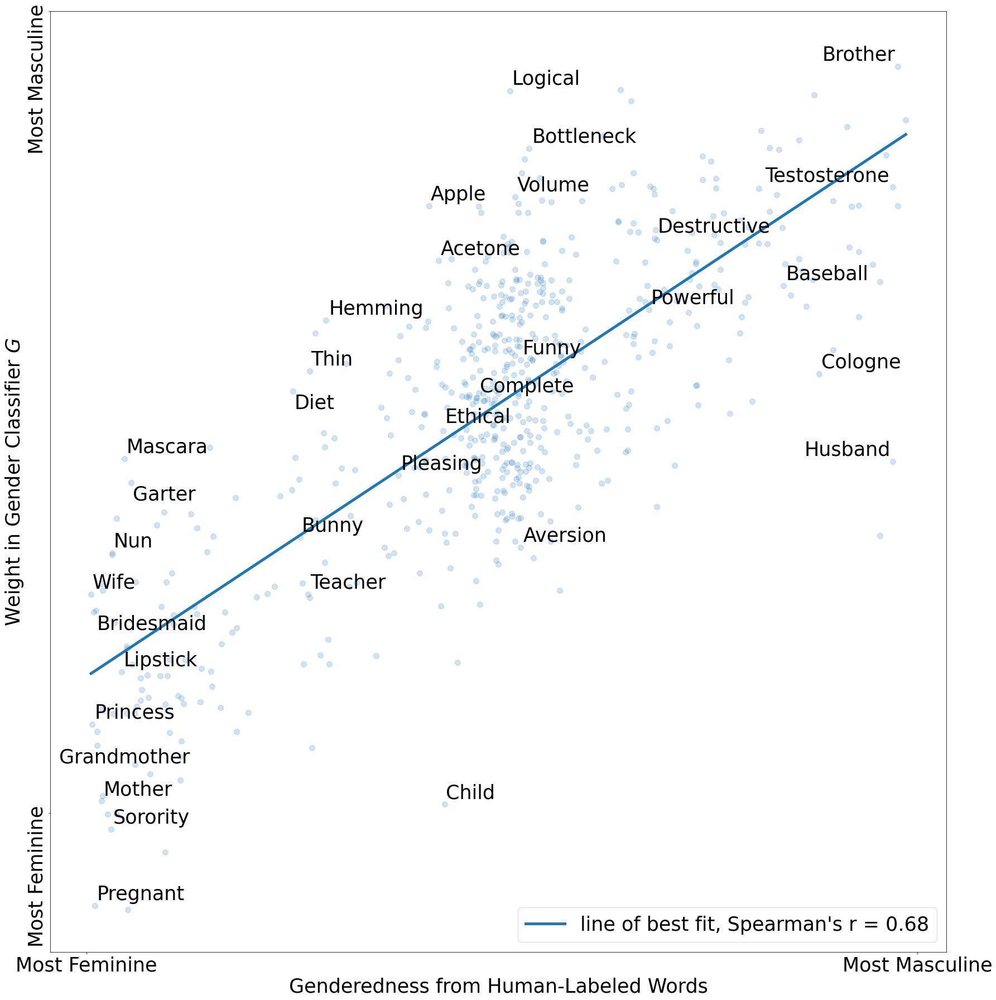

In [36]:
# plot to compare gender classifier words to human-labeled scores
import pandas as pd


gender_words_df = pd.read_csv('csvs/crawford2004.csv')
gender_words = list(gender_words_df['Stimulus Word'])[1:]
gender_nj = list(gender_words_df['NJ mean'])[1:]

# get word embeddings
candwordvecs = []
wordlist = []
temp_gender_nj = []
for i,k in enumerate(gender_words):
    temp = word_vector_featurize(k, E)
    # if statement to remove words that do not have embeddings
    if type(temp) == np.ndarray:
        candwordvecs.append(temp)
        wordlist.append(k)
        temp_gender_nj.append(gender_nj[i])

gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 

xs = temp_gender_nj
ys = gender_dots
labels =wordlist
m, b = np.polyfit(xs, ys, 1)
corr_r =  scipy.stats.spearmanr(xs,ys)[0]

plt.figure(figsize=(25,25))


my_xticks = ['Most Feminine','Most Masculine']

plt.scatter(xs,ys,alpha=0.2,s=100)
plt.plot(xs, m*np.array(xs)+ b,linewidth=5,label='line of best fit, Spearman\'s r = %.2f'%corr_r)
x = np.array([1, 5])
plt.xticks(x, my_xticks,fontsize=fontsizeval)
# plt.yticks(y,my_xticks,fontsize=15)
my_xticks = ['Most Feminine','Most Masculine']
y = np.array([-0.23,0.19])
plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
plt.xlabel("Genderedness from Human-Labeled Words",size = fontsizeval )
plt.ylabel("Weight in Gender Classifier $G$", size=fontsizeval)
xs,ys,ls= text_plot_words_locs(xs,ys,labels,2,width=30,height=30)
texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(xs, ys, ls)]
adjust_text(texts)
plt.legend(loc='lower right',fontsize=fontsizeval)
plt.tight_layout()
plt.savefig("figures/humancorr.pdf", bbox_inches='tight')


In [271]:
corr_r

0.6787142172935811

# Plot importance of words

In [48]:
def get_color_gradient(xs,ys,inv=False):
    CB_color_cycle = [(0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
(1.0, 0.4980392156862745, 0.0),
(0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
(0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
(0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
(0.596078431372549, 0.3058823529411765, 0.6392156862745098),
(0.6, 0.6, 0.6),
(0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
(0.8705882352941177, 0.8705882352941177, 0.0),]
    dists = np.array([min(abs(i),abs(j)) for i,j in zip(xs,ys)])
    dists = dists/max(dists)
    if inv:
        lightness = [min(1,round(d,2)+0.15) for d in dists]
    else:
        lightness = [(1-round(d,2))*0.5 for d in dists]

    colors = []
    markers = []
    for x,y,l in zip(xs,ys,lightness):
        if x > 0:
            if y > 0:
                c = CB_color_cycle[0] + (l,) #(r,g,b,alpha)
            else:
                
                c = CB_color_cycle[2] + (l,)
        else:
            if y > 0:
                c = CB_color_cycle[1] + (l,)
            else: 
                c = CB_color_cycle[3] + (l,)
        colors.append(c)
    return colors

In [8]:
import numpy as np
words = np.load('results/words.npy')
def sort_helper(i):
    x = words[i]
    if x in words_by_freq:
        return words_by_freq[x]
    return 0
# words = np.array(vectorizer.get_feature_names())
occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]

occ_classers = pkl.load(open('results/we_occ_classers.pkl','rb'))

surgeon


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


software_engineer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


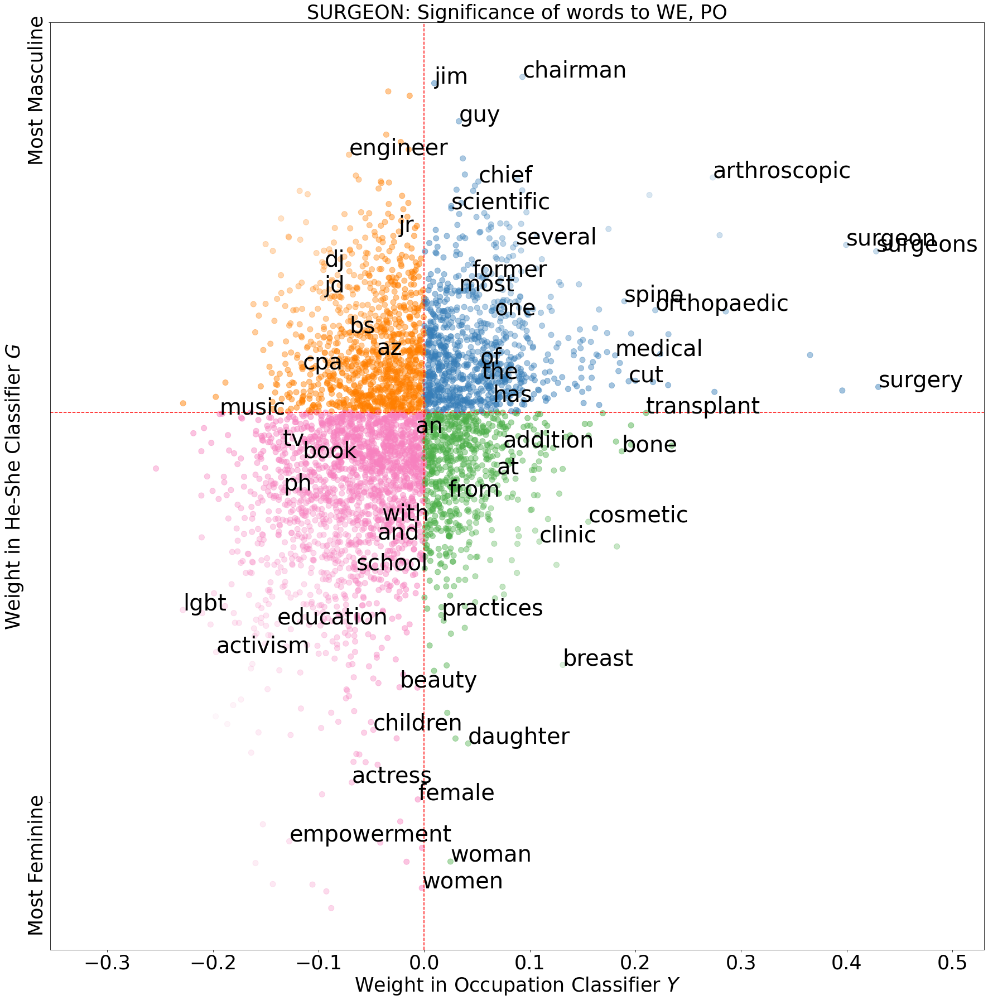

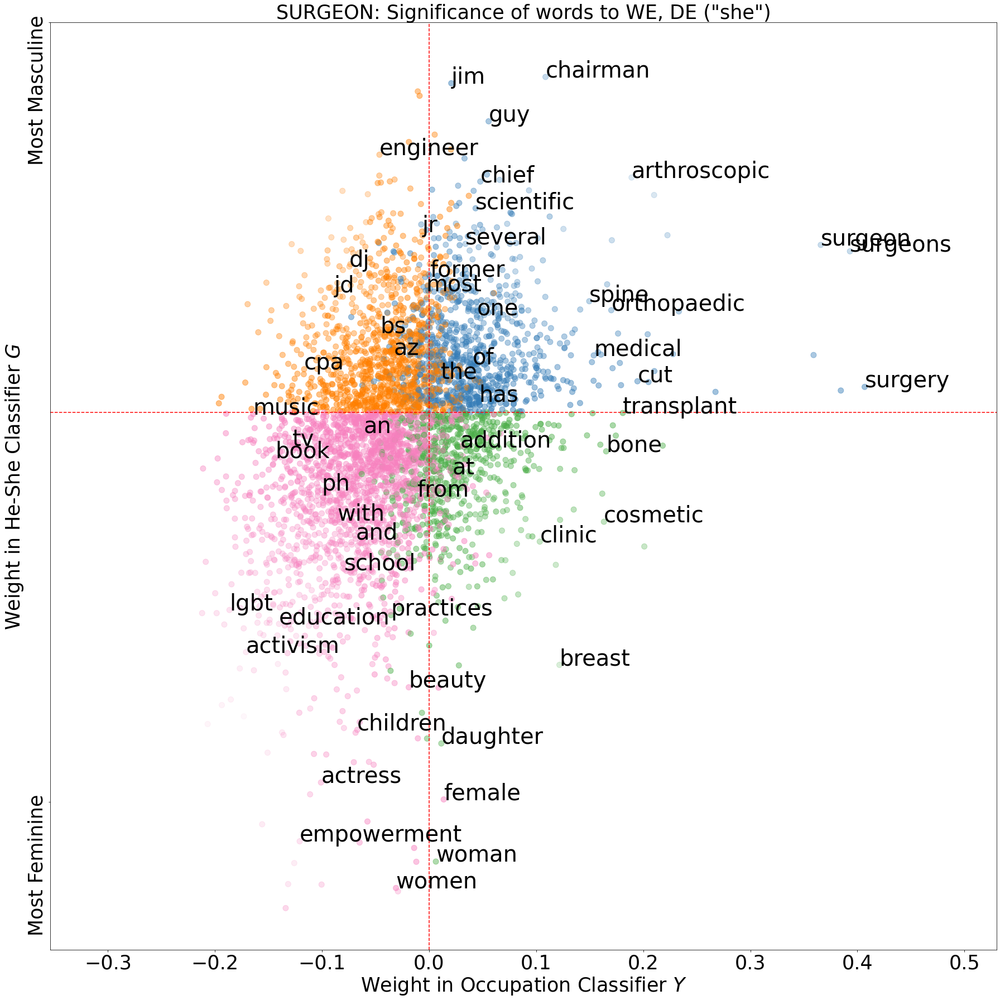

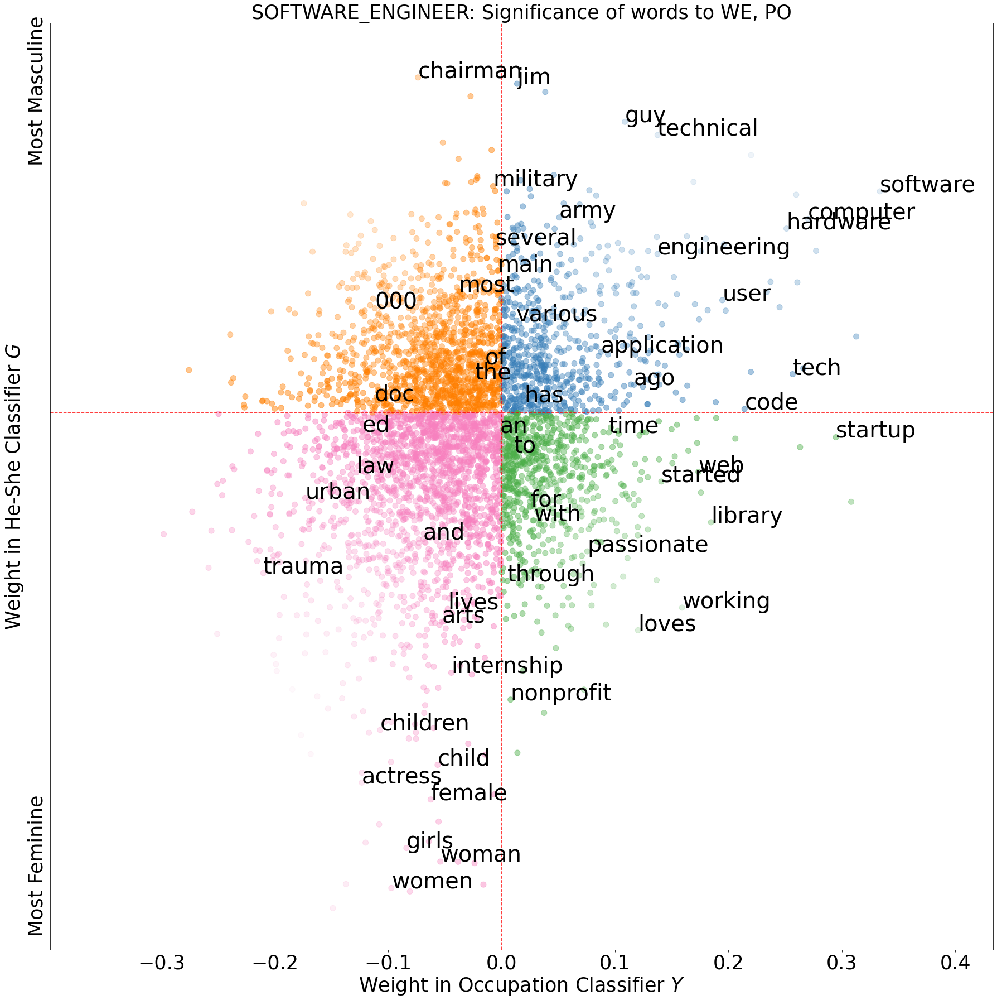

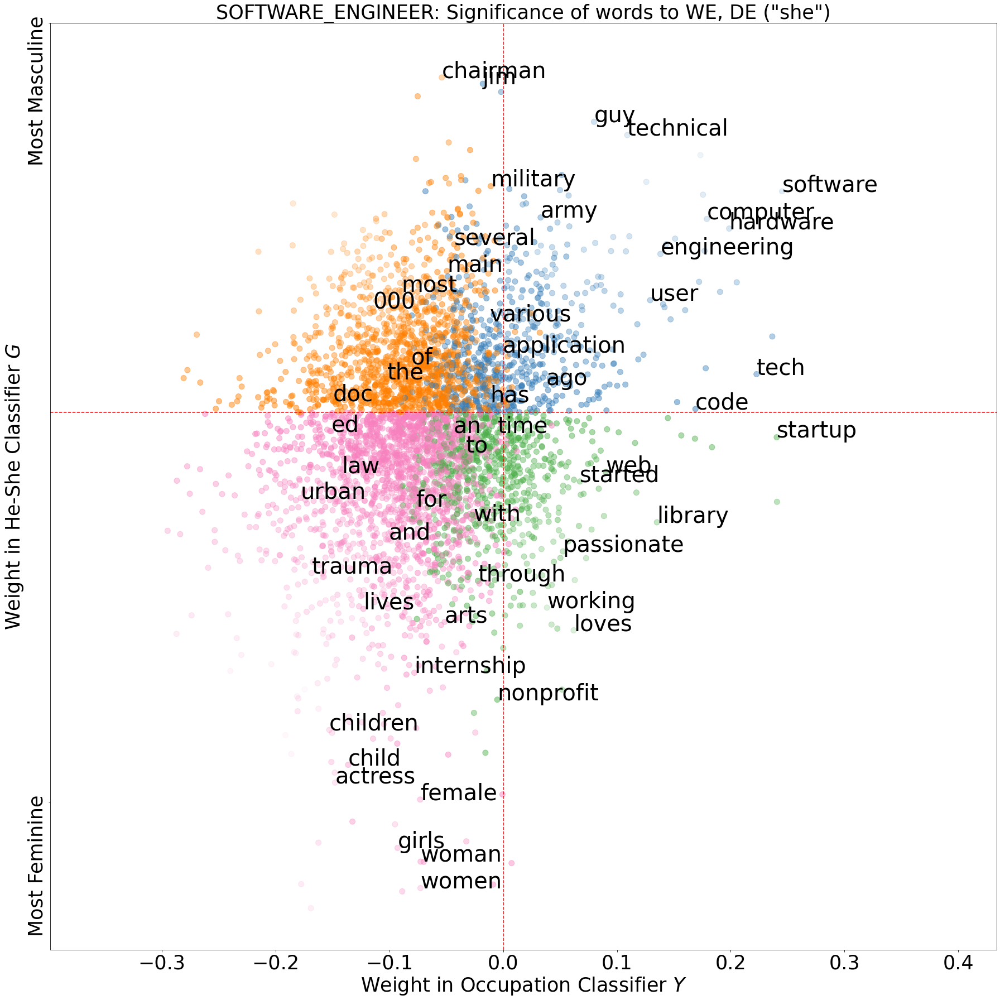

In [51]:
fontsizeval=35
for target_occ in ['surgeon','software_engineer']:
#                    ,'professor','nurse']:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_joint = [sim_emb(occ_classers[target_occ]['clf_bow_joint'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
    
    xs = occ_dots_joint
    ys = gender_dots
    colors = get_color_gradient(occ_dots_joint,gender_dots)
    plt.scatter(xs,ys,color=colors,s=100)
    plt.xlim([min(occ_dots_joint)-0.1,max(occ_dots_joint)+0.1])
    plt.axhline(y=0, color='r', linestyle='dashed')
    plt.axvline(x=0, color='r', linestyle='dashed')
    my_xticks = ['Most Feminine','Most Masculine']
    y = np.array([-0.25,0.25])
    
    plt.xticks(fontsize=fontsizeval)
    plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
    plt.title(target_occ.upper() + ': Significance of words to WE, PO',fontsize=fontsizeval)
    xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
    ylabel("Weight in He-She Classifier $G$", size=fontsizeval)

    xs_og,ys_og,ls_og= text_plot_words_locs(xs,ys,labels,2,width=30)
    # ylabel(y_label, size=20)
    texts = [plt.text(x,y,l,size=fontsizeval+5) for x, y, l in zip(xs_og, ys_og, ls_og)]
#     adjust_text(texts)

    plt.tight_layout()
    plt.savefig("figures/%s_1.pdf"%target_occ, bbox_inches='tight')


    plt.figure(figsize=(25,25))
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_f'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
    
    xs = occ_dots_f
    ys = gender_dots
#     colors = get_color_gradient(occ_dots_f,gender_dots)
    # ylabel(y_label, size=20)
    plt.xlim([min(occ_dots_joint)-0.1,max(occ_dots_joint)+0.1])
    plt.scatter(xs,ys,color=colors,s=100)
    plt.axhline(y=0, color='r', linestyle='dashed')
    plt.axvline(x=0, color='r', linestyle='dashed')
    my_xticks = ['Most Feminine','Most Masculine']
    y = np.array([-0.25,0.25])
    plt.xticks(fontsize=fontsizeval)
    plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
    plt.title(target_occ.upper() + ': Significance of words to WE, DE ("she")',fontsize=fontsizeval)
    xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
    ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    
    inds = []
    for i in ls_og:
        inds.append(np.where(np.array(labels)==i)[0][0])
    

    temp_xs = np.array(occ_dots_f)[inds]
        
        
    texts = [plt.text(x,y,l,size=fontsizeval+5) for x, y, l in zip(temp_xs, ys_og, ls_og)]
#     adjust_text(texts)
    plt.tight_layout()
    plt.savefig("figures/%s_2.pdf"%target_occ, bbox_inches='tight')
    
    
#     plt.figure(figsize=(25,25))
#     occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_joint_sampleweights'].coef_[0],w) for w in candwordvecs] 
    
#     labels = wordlist
    
#     xs = occ_dots_f
#     ys = gender_dots
# #     colors = get_color_gradient(occ_dots_f,gender_dots)
#     # ylabel(y_label, size=20)
#     plt.xlim([min(occ_dots_joint)-0.1,max(occ_dots_joint)+0.1])
#     plt.scatter(xs,ys,color=colors,s=100)
#     plt.axhline(y=0, color='r', linestyle='dashed')
#     plt.axvline(x=0, color='r', linestyle='dashed')
#     my_xticks = ['Most Feminine','Most Masculine']
#     y = np.array([-0.25,0.25])
#     plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
#     plt.title(target_occ.upper() + ': Significance of words to WE, PR',fontsize=fontsizeval)
#     xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
#     ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    
#     inds = []
#     for i in ls_og:
#         inds.append(np.where(np.array(labels)==i)[0][0])
    

#     temp_xs = np.array(occ_dots_f)[inds]
        
        
#     texts = [plt.text(x,y,l,size=fontsizeval+5) for x, y, l in zip(temp_xs, ys_og, ls_og)]
# #     adjust_text(texts)
#     plt.tight_layout()
#     plt.savefig("figures/%s_pr.pdf"%target_occ, bbox_inches='tight')


surgeon
-0.25065794014990916
0.4068249872509156


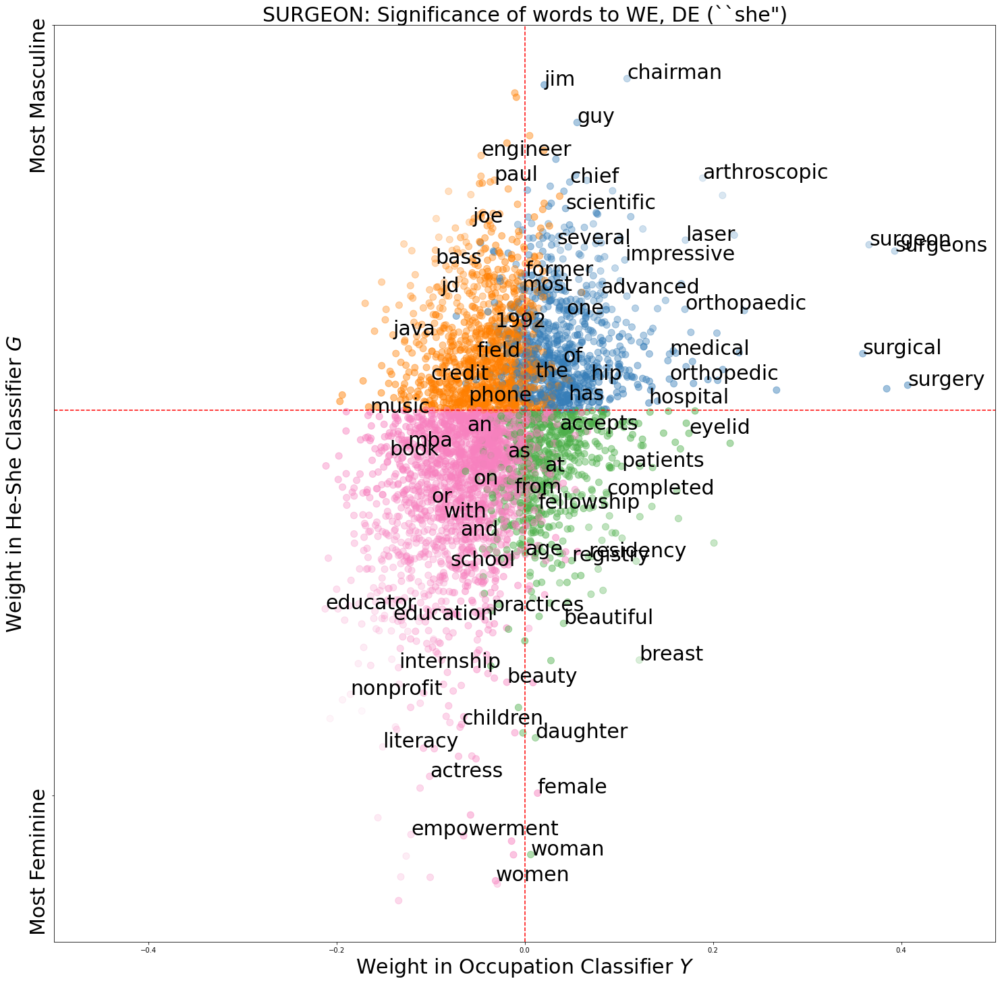

In [249]:
for target_occ in ['surgeon']:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_f'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
    
    xs = occ_dots_f
    ys = gender_dots
#     colors = get_color_gradient(occ_dots_f,gender_dots)
    # ylabel(y_label, size=20)
    plt.xlim([-0.5,0.5])
    plt.scatter(xs,ys,color=colors,s=100)
    print(min(xs))
    print(max(xs))
    plt.axhline(y=0, color='r', linestyle='dashed')
    plt.axvline(x=0, color='r', linestyle='dashed')
    my_xticks = ['Most Feminine','Most Masculine']
    y = np.array([-0.25,0.25])
    plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
    plt.title(target_occ.upper() + ': Significance of words to WE, DE (``she")',fontsize=fontsizeval)
    xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
    ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    xs,ys,ls= text_plot_words_locs(xs,ys,labels,2,width=50)

    texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(xs, ys, ls)]
#     adjust_text(texts)

professor


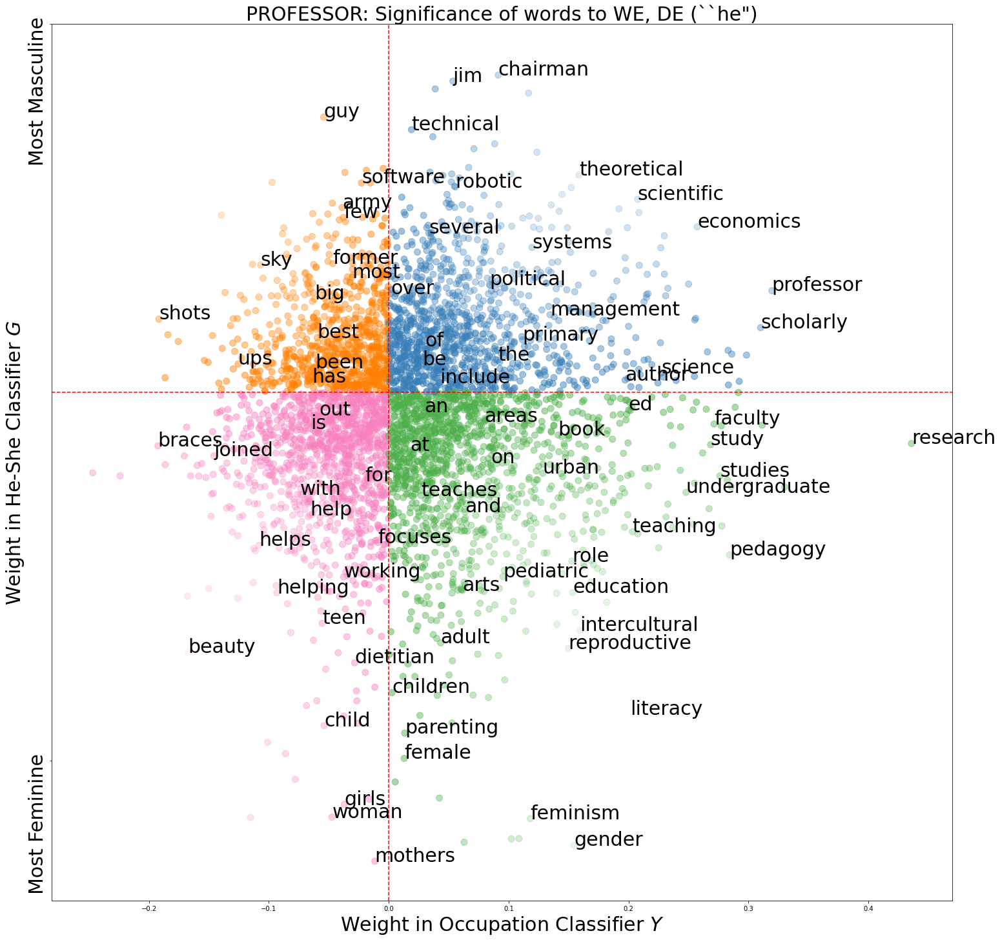

In [194]:
for target_occ in ['professor']:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clm_bow_m'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
    
    xs = occ_dots_f
    ys = gender_dots
    colors = get_color_gradient(occ_dots_f,gender_dots)
    plt.scatter(xs,ys,color=colors,s=100)

    plt.axhline(y=0, color='r', linestyle='dashed')
    plt.axvline(x=0, color='r', linestyle='dashed')
    my_xticks = ['Most Feminine','Most Masculine']
    y = np.array([-0.25,0.25])
    plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
    plt.title(target_occ.upper() + ': Significance of words to WE, DE (``he")',fontsize=fontsizeval)
    xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
    ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    xs,ys,ls= text_plot_words_locs(xs,ys,labels,2,width=50)
    # ylabel(y_label, size=20)
    texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(xs, ys, ls)]
#     adjust_text(texts)

surgeon


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


software_engineer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


composer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


pastor


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


comedian


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


architect


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


chiropractor


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


accountant


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


attorney


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


filmmaker


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


physician


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


dentist


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


photographer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


professor


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


painter


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


journalist


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


poet


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


personal_trainer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


teacher


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


interior_designer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


yoga_teacher


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


nurse


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


dietitian


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
MovieWriter ffmpeg unavailable; using Pillow instead.


<Figure size 1800x1800 with 0 Axes>

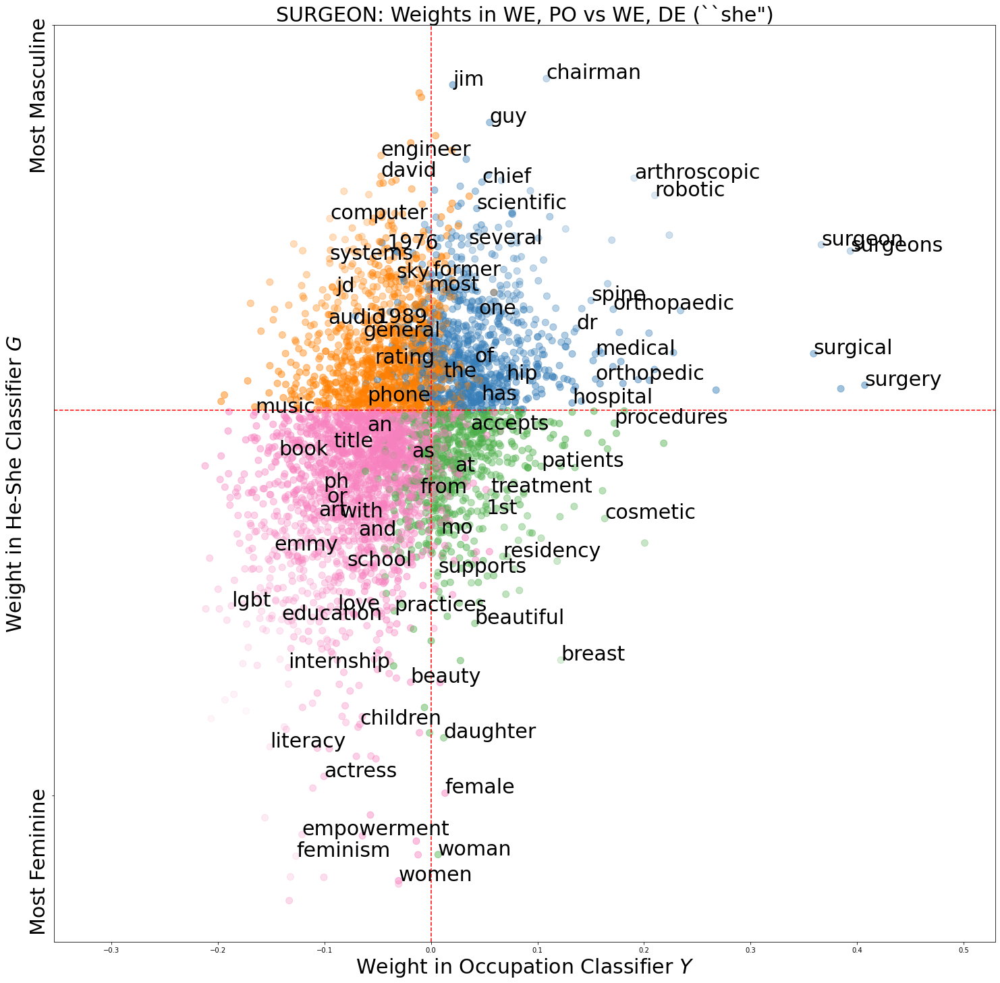

<Figure size 1800x1800 with 0 Axes>

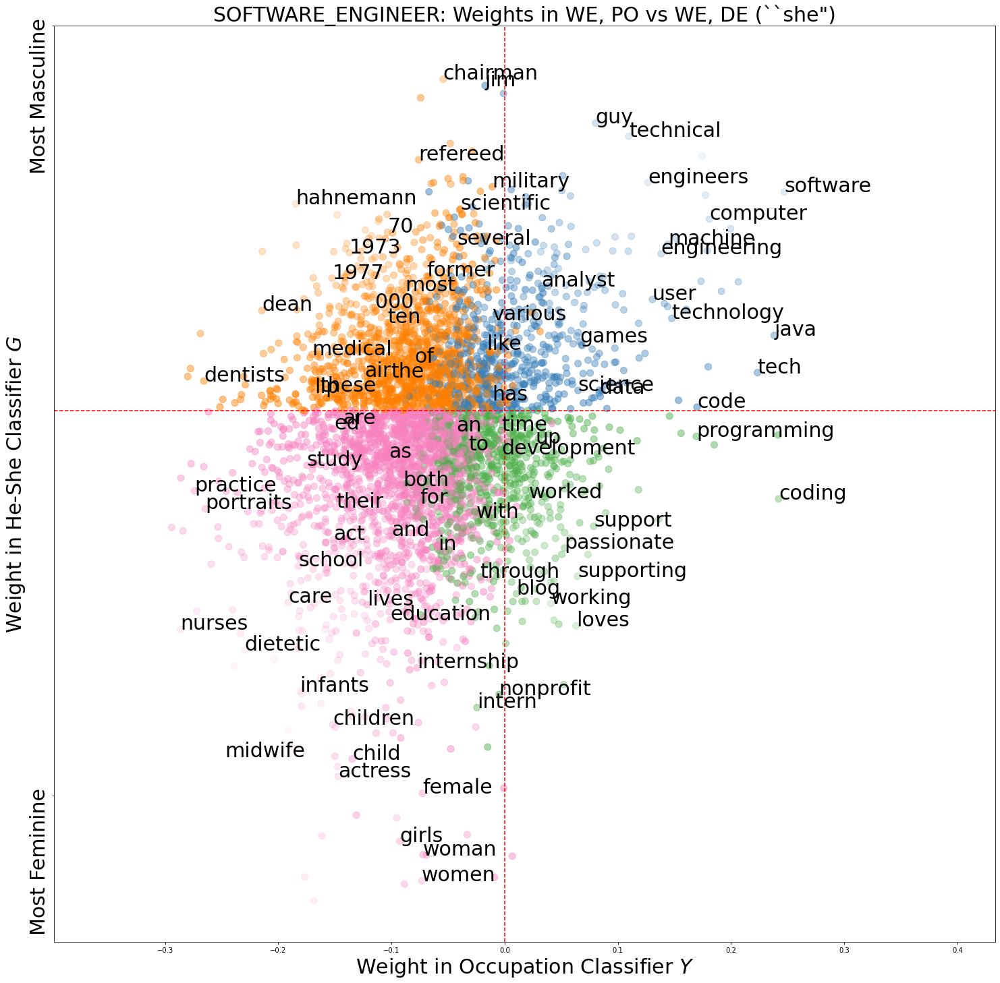

<Figure size 1800x1800 with 0 Axes>

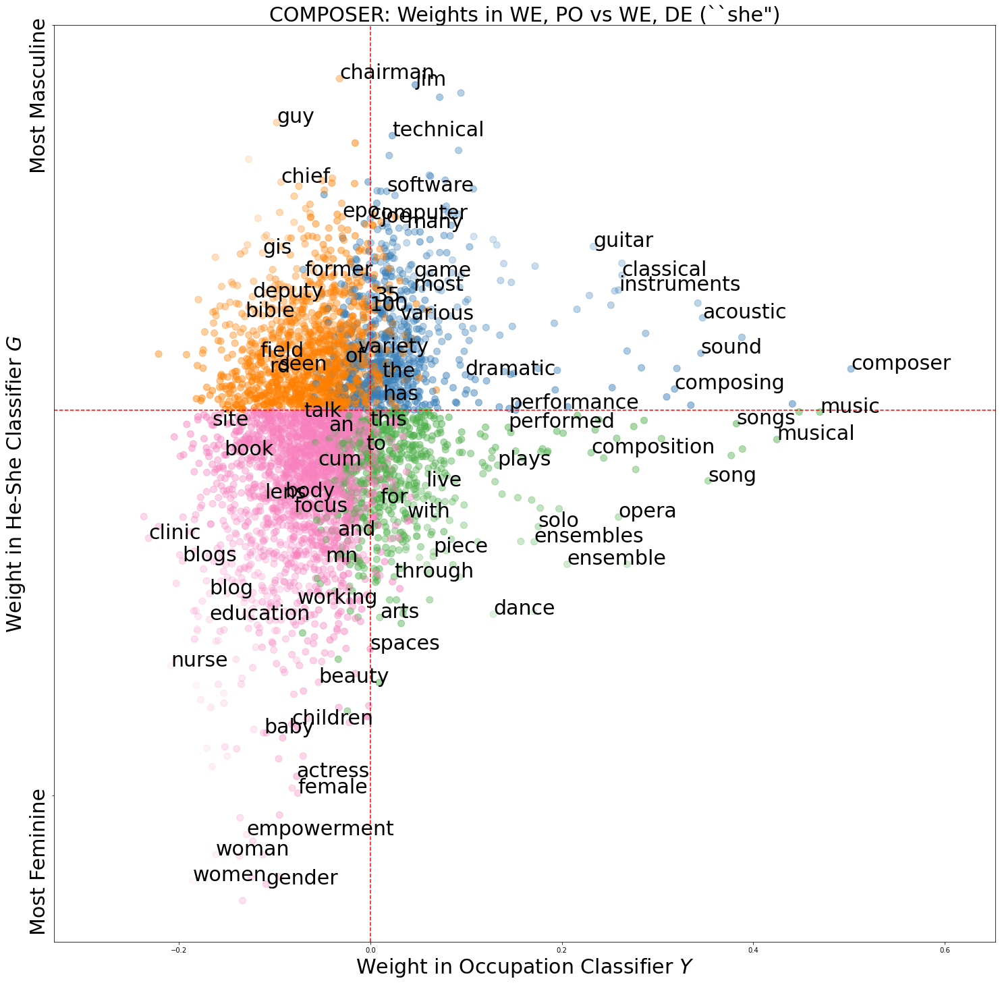

<Figure size 1800x1800 with 0 Axes>

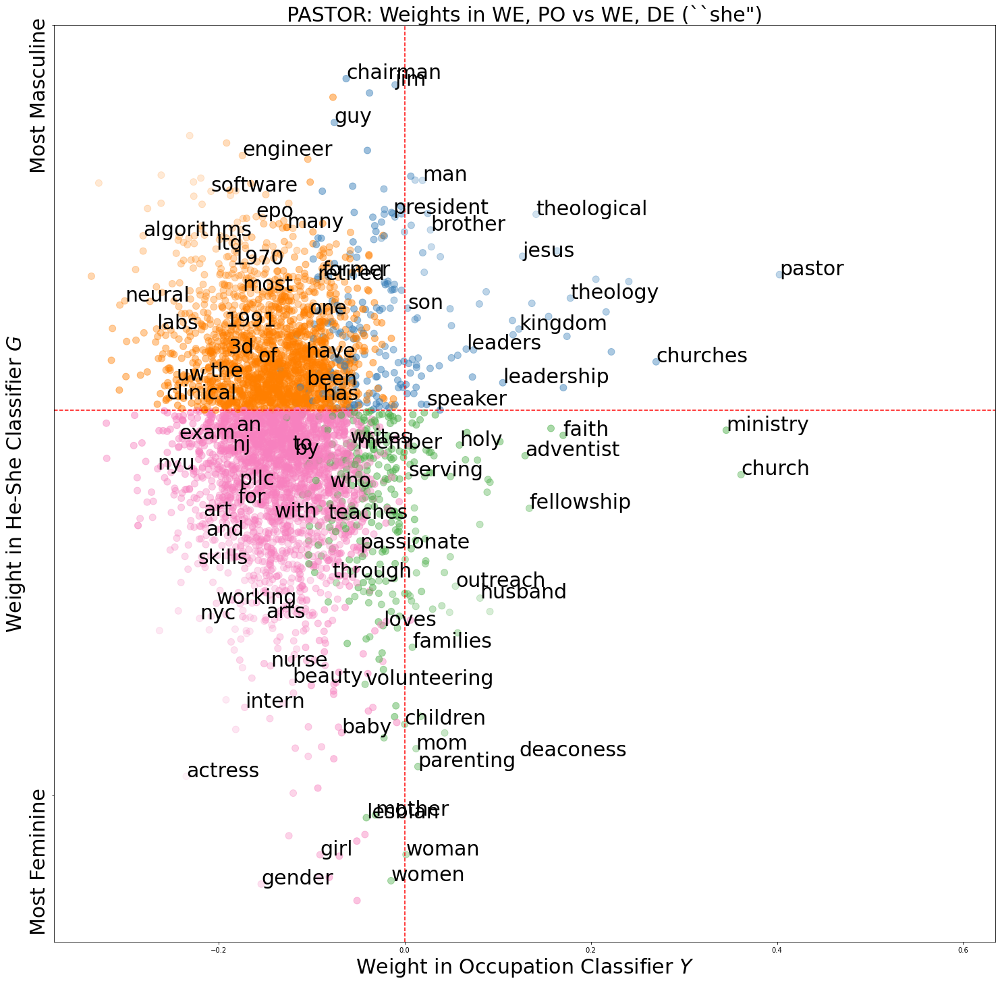

<Figure size 1800x1800 with 0 Axes>

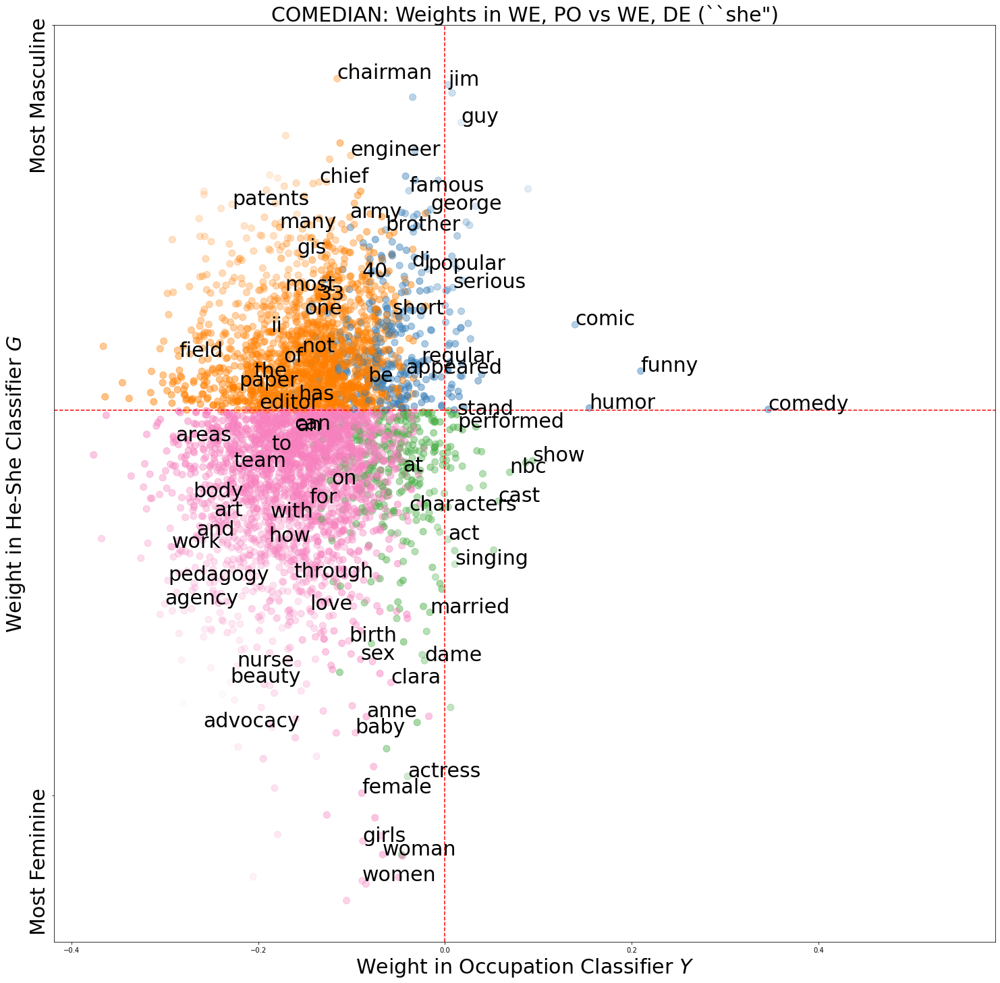

<Figure size 1800x1800 with 0 Axes>

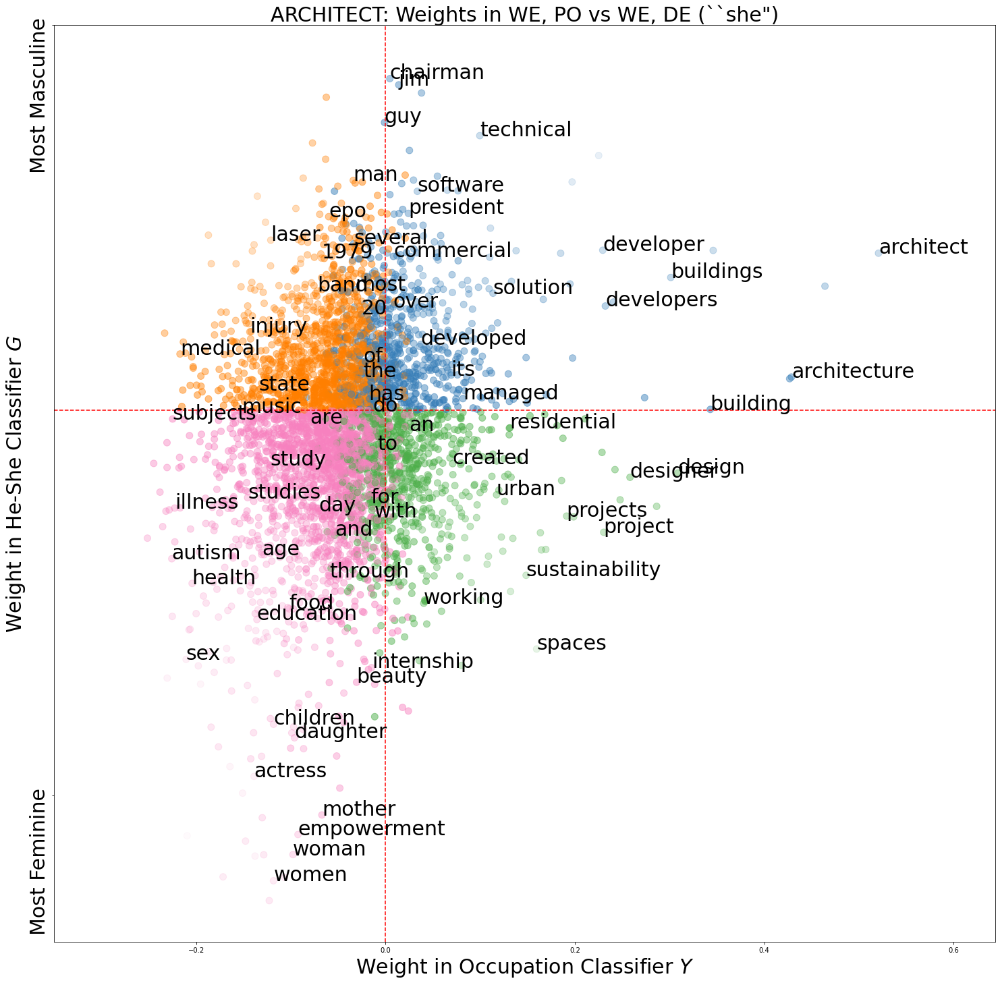

<Figure size 1800x1800 with 0 Axes>

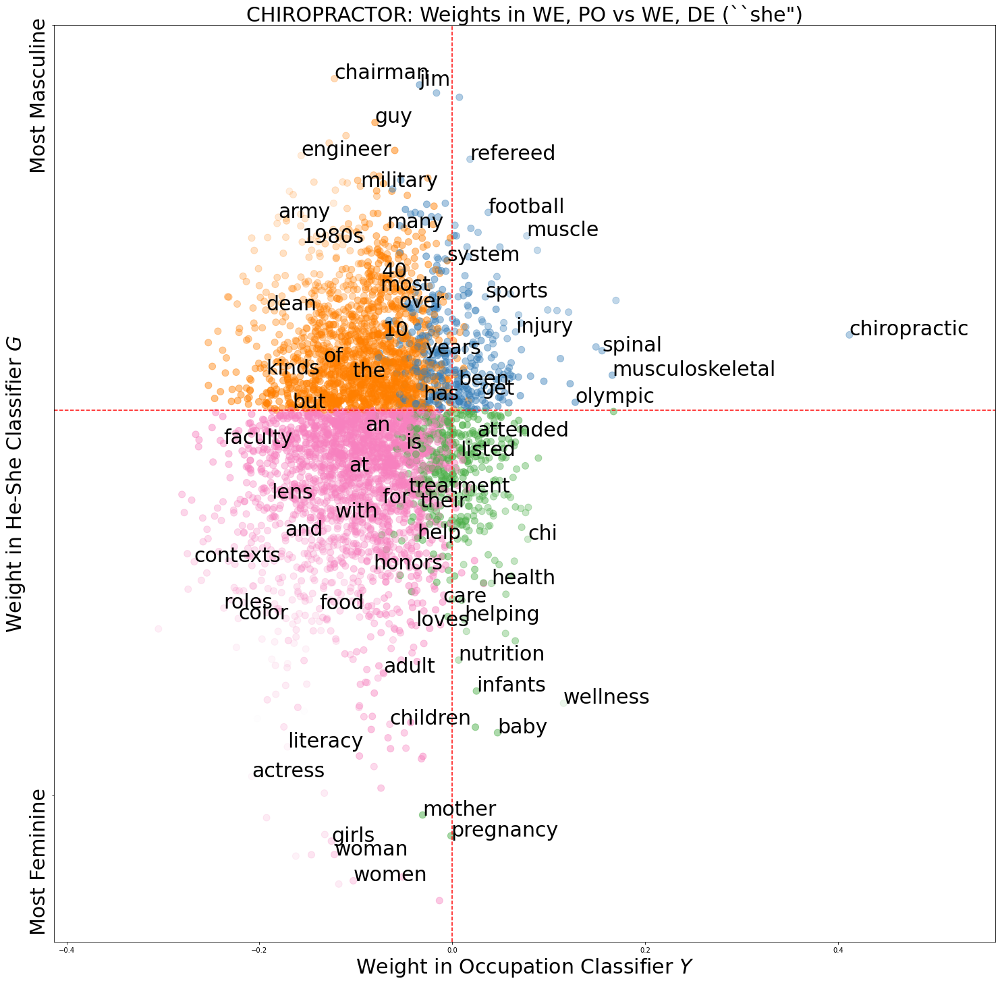

<Figure size 1800x1800 with 0 Axes>

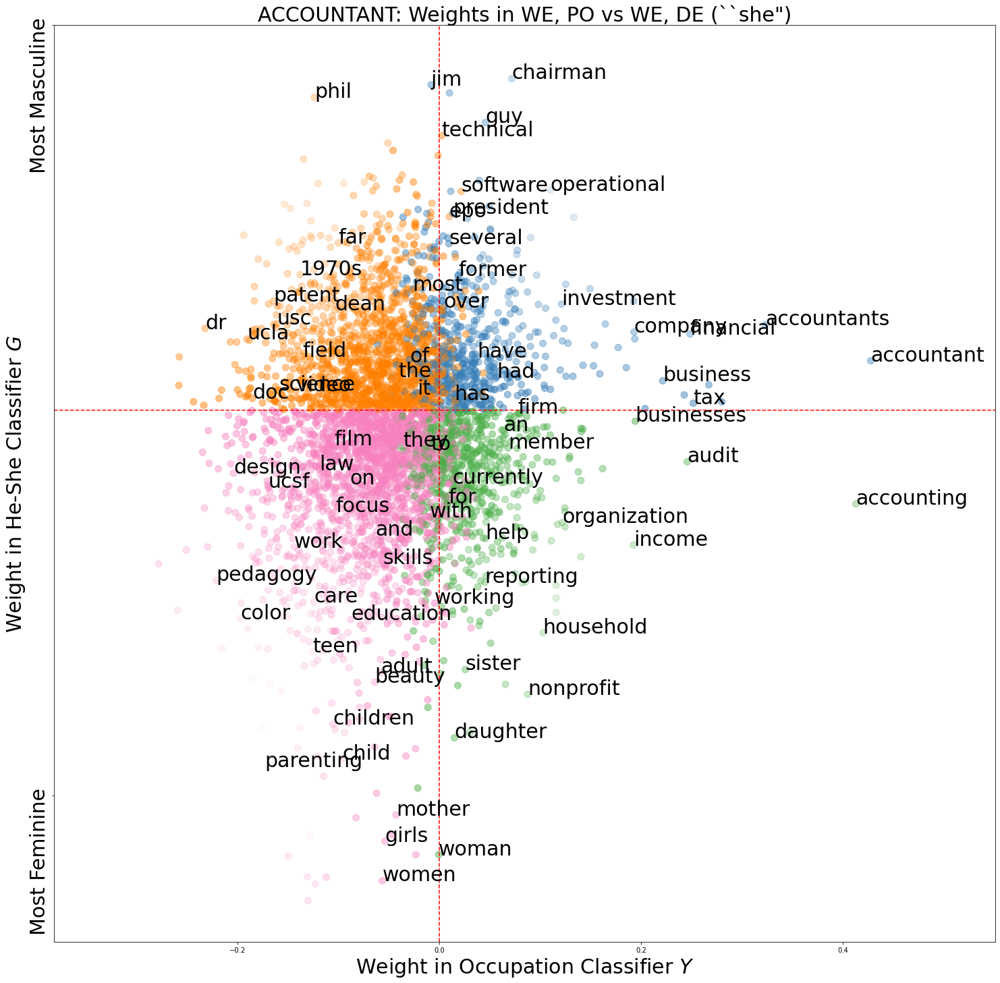

<Figure size 1800x1800 with 0 Axes>

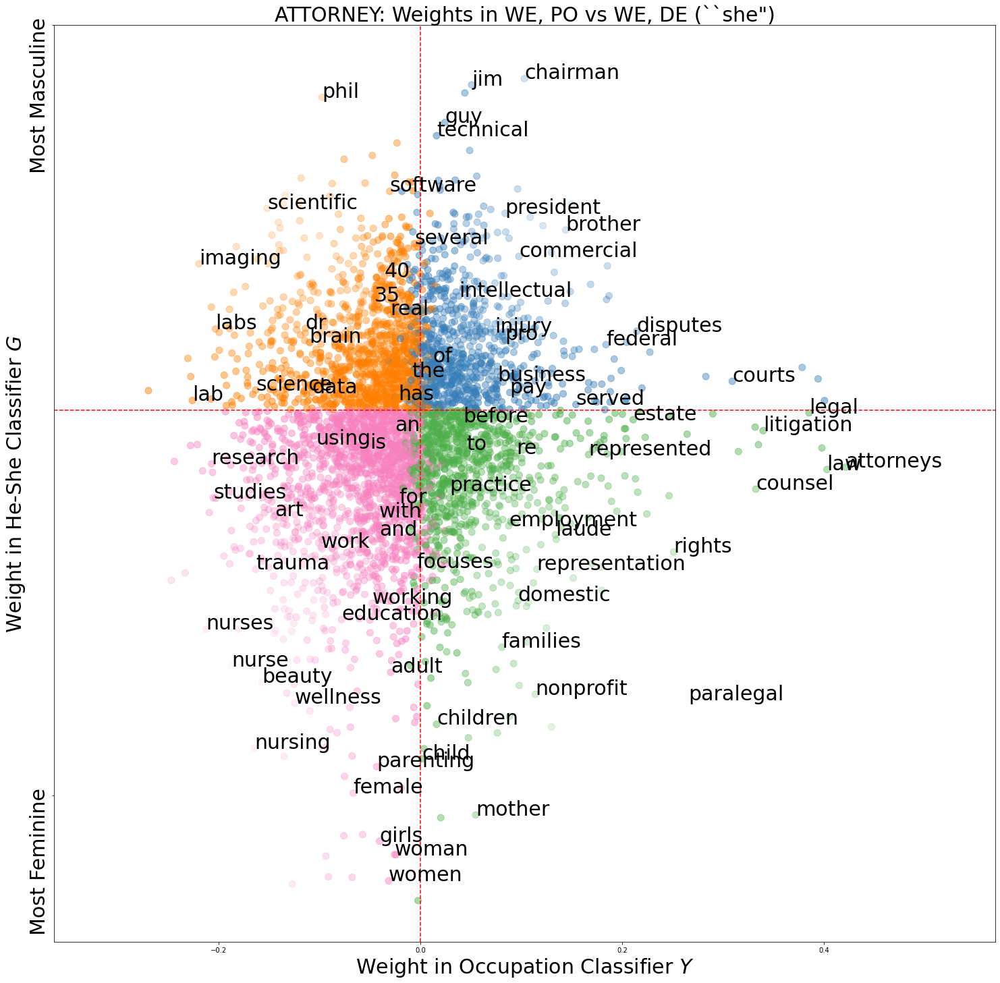

<Figure size 1800x1800 with 0 Axes>

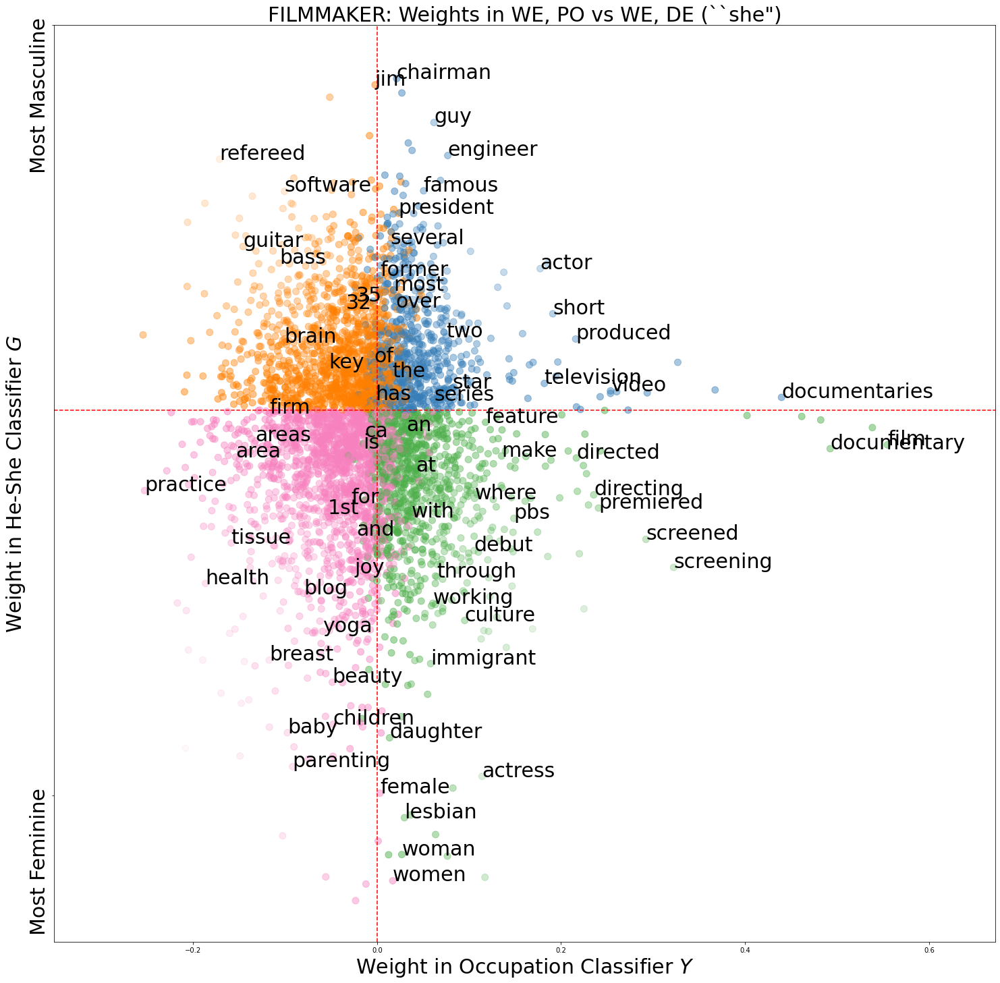

<Figure size 1800x1800 with 0 Axes>

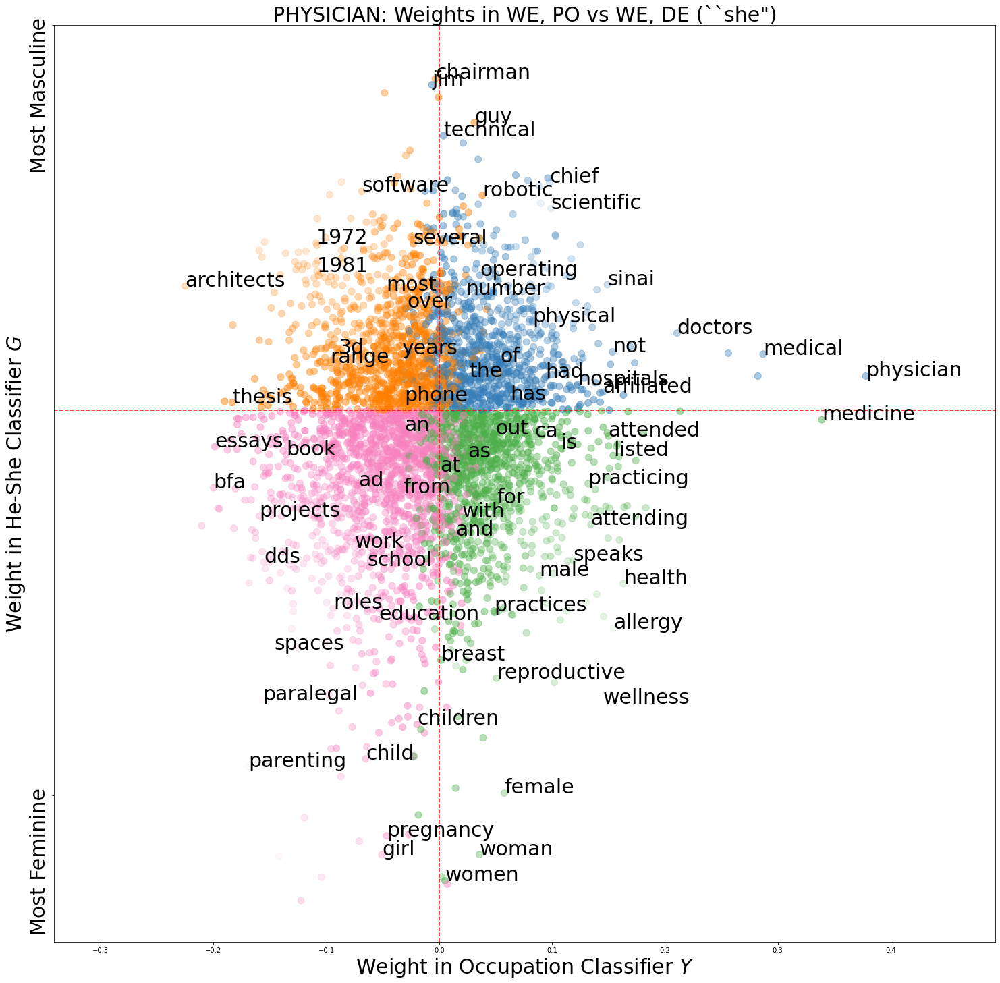

<Figure size 1800x1800 with 0 Axes>

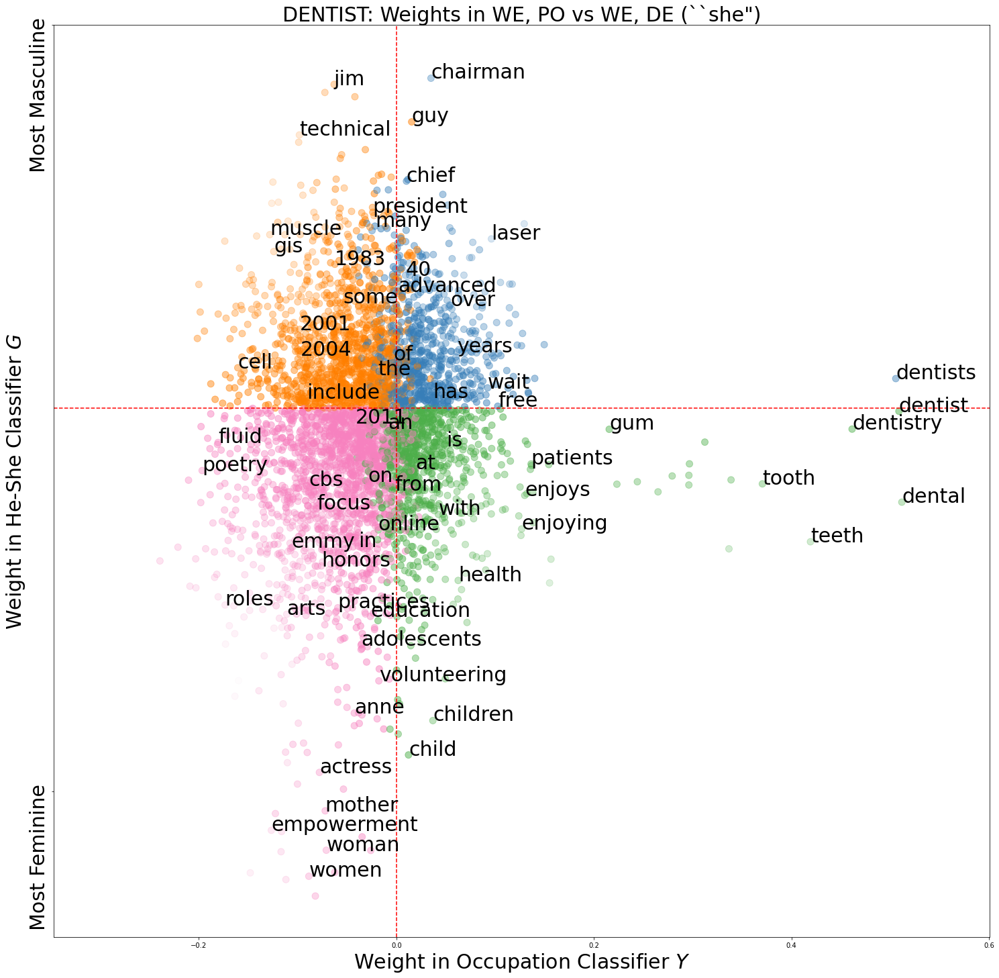

<Figure size 1800x1800 with 0 Axes>

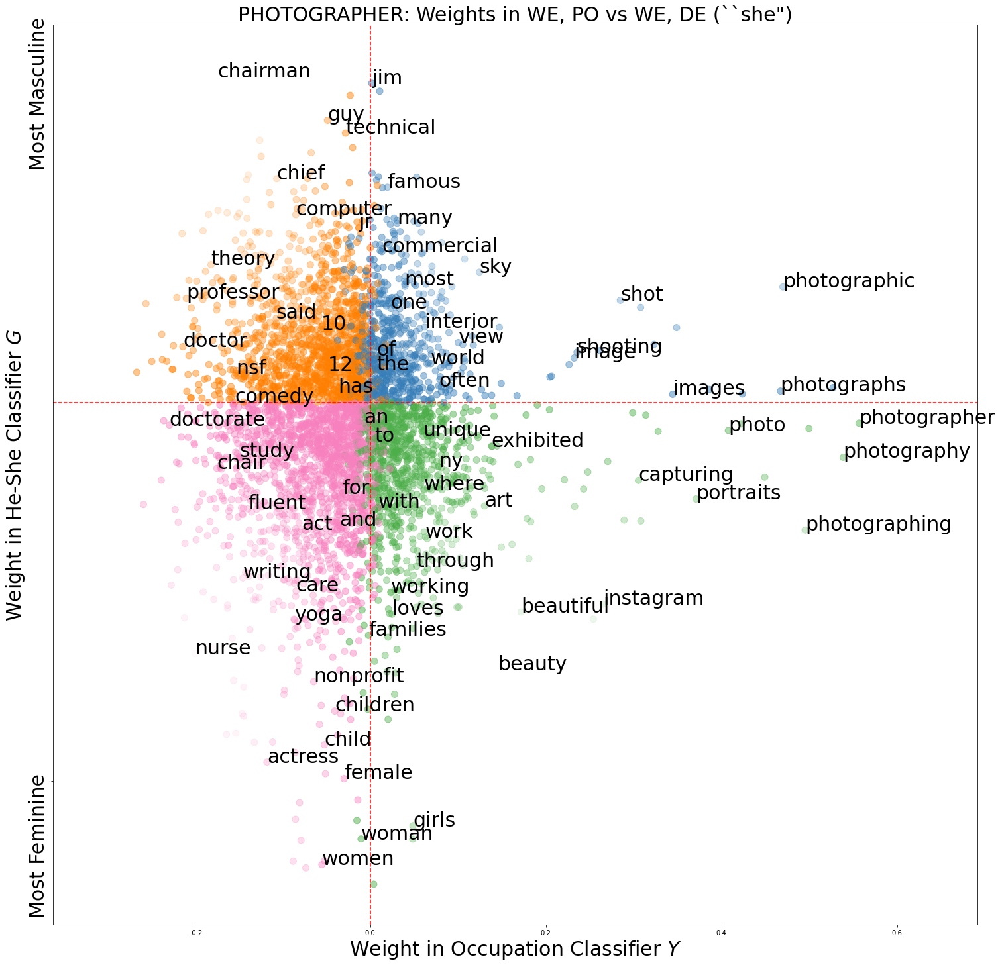

<Figure size 1800x1800 with 0 Axes>

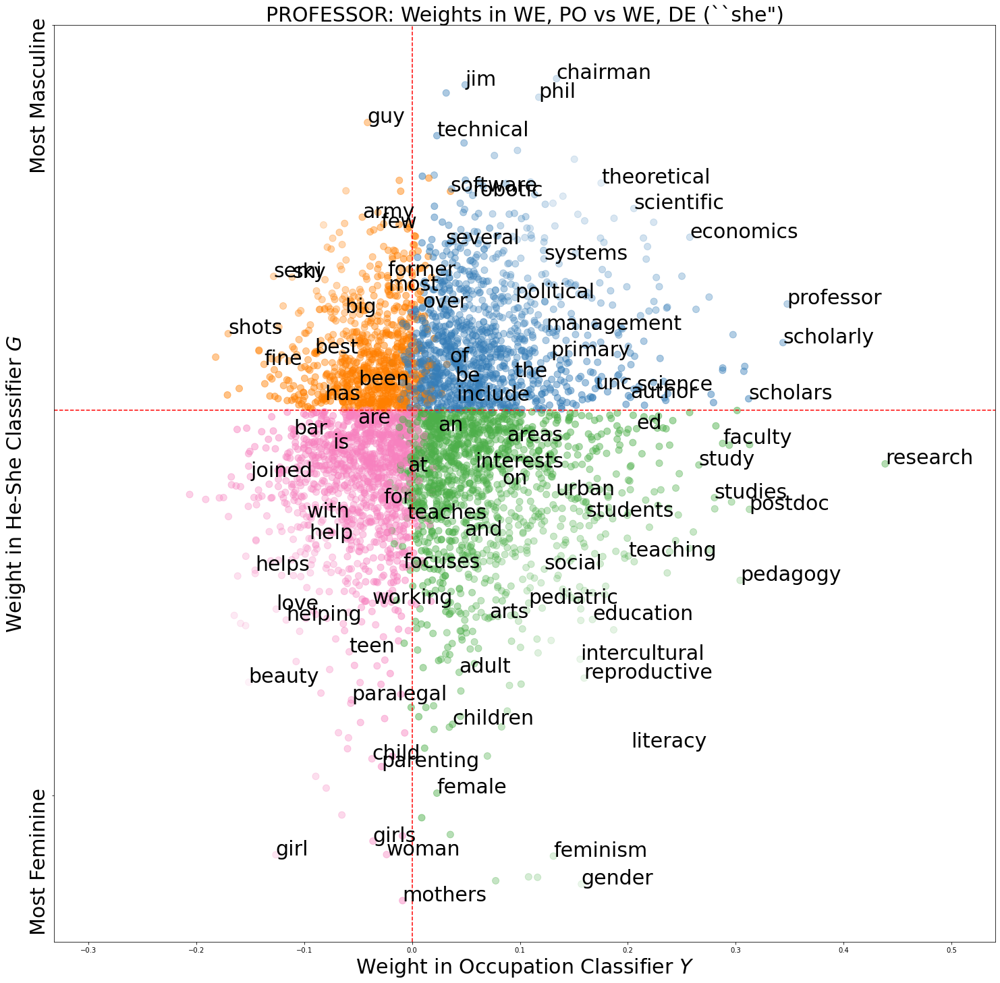

<Figure size 1800x1800 with 0 Axes>

In [ ]:
from celluloid import Camera
words = np.load('results/words.npy')
def sort_helper(i):
    x = words[i]
    if x in words_by_freq:
        return words_by_freq[x]
    return 0
occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


for target_occ in occs:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_f'].coef_[0],w) for w in candwordvecs] 
    occ_dots_joint = [sim_emb(occ_classers[target_occ]['clf_bow_joint'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
    colors = get_color_gradient(occ_dots_joint,gender_dots)
    camera = Camera(plt.figure(figsize=(25,25)))
    
    xs,ys,ls= text_plot_words_locs(occ_dots_joint,gender_dots,labels,2,width=50)
    inds = []
    for i in ls:
        inds.append(np.where(np.array(labels)==i)[0][0])
#     print(len(xs))
#     print(len(inds))

    for i in range(50):
        points = occ_dots_joint.copy()
        
        points += (np.array(occ_dots_f)-np.array(occ_dots_joint))*0.02*i
        temp_xs = np.array(xs) +(np.array(occ_dots_f)[inds]-np.array(occ_dots_joint)[inds])*0.02*i


        my_xticks = ['Most Feminine','Most Masculine']
        y = np.array([-0.25,0.25])
   
        
        plt.xlim([min(occ_dots_joint)-0.1,max(occ_dots_joint)+0.1])

    
        texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(temp_xs,ys, ls)]
        
        plt.scatter(points, gender_dots,c=colors,s=100)
        plt.axhline(y=0, color='r', linestyle='dashed')
        plt.axvline(x=0, color='r', linestyle='dashed')
        
        plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
        plt.title(target_occ.upper() + ': Weights in WE, PO vs WE, DE (``she")',fontsize=fontsizeval)
        xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
        ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    
    
        camera.snap()
    anim = camera.animate(blit=True)
    anim.save('gifs/scatter_%s_final_de.gif'%target_occ)
  
        

In [ ]:
from celluloid import Camera
words = np.load('results/words.npy')
def sort_helper(i):
    x = words[i]
    if x in words_by_freq:
        return words_by_freq[x]
    return 0
occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


for target_occ in occs:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_joint_sampleweights'].coef_[0],w) for w in candwordvecs] 
    occ_dots_joint = [sim_emb(occ_classers[target_occ]['clf_bow_joint'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
    colors = get_color_gradient(occ_dots_joint,gender_dots)
    camera = Camera(plt.figure(figsize=(25,25)))
    
    xs,ys,ls= text_plot_words_locs(occ_dots_joint,gender_dots,labels,2,width=50)
    inds = []
    for i in ls:
        inds.append(np.where(np.array(labels)==i)[0][0])
#     print(len(xs))
#     print(len(inds))

    for i in range(50):
        points = occ_dots_joint.copy()
        
        points += (np.array(occ_dots_f)-np.array(occ_dots_joint))*0.02*i
        temp_xs = np.array(xs) +(np.array(occ_dots_f)[inds]-np.array(occ_dots_joint)[inds])*0.02*i


        my_xticks = ['Most Feminine','Most Masculine']
        y = np.array([-0.25,0.25])
   
        
        plt.xlim([min(occ_dots_joint)-0.1,max(occ_dots_joint)+0.1])

    
        texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(temp_xs,ys, ls)]
        
        plt.scatter(points, gender_dots,c=colors,s=100)
        plt.axhline(y=0, color='r', linestyle='dashed')
        plt.axvline(x=0, color='r', linestyle='dashed')
        
        plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
        plt.title(target_occ.upper() + ': Weights in WE, PO vs WE, PR',fontsize=fontsizeval)
        xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
        ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    
    
        camera.snap()
    anim = camera.animate(blit=True)
    anim.save('gifs/scatter_%s_final_pr.gif'%target_occ)
  
        

# Plot g_irrev things

In [18]:
chi_gender_classers = pkl.load(open('results/we_chi_gender_classers.pkl','rb'))
chi_gender_classers_or = pkl.load(open('results/we_chi_gender_classers_or.pkl','rb'))

chi_vectorizers=pkl.load(open('results/bow_chi_vectorizers.pkl','rb'))
y_preds_tpr = pkl.load(open('results/we_tpr_fairlearn_preds.pkl','rb'))


In [19]:
chi_gender_classers_or = pkl.load(open('results/we_chi_gender_classers_or.pkl','rb'))
chi_vectorizers_or=pkl.load(open('results/bow_chi_vectorizers_or.pkl','rb'))


In [210]:
0

0

In [213]:


# make embeddings that contain only the task irrelevant words
from scipy.stats import chi2
prob = 0.99
critical = chi2.ppf(prob, 1)
occupation_embeddings = {}


thr = critical
for occ in occs:
    all_words = list(chi_vectorizers_or[occ][thr].vocabulary_.keys())
    new_dict = {}
    for w in all_words:
        if w in E:
            new_dict[w] = E[w]
    occupation_embeddings[occ+"%.2f"%thr] = new_dict


def word_vector_featurize_occ(text, occupation, Emb = E):
    return mean([occupation_embeddings[occupation + "%.2f"%critical][w] for w in re.split(r"[\s\.\!\?\:,\"“\—\-\(\)]+", text) if len(w)>1 and w in occupation_embeddings[occupation+ "%.2f"%critical]], axis=0)



In [272]:
# get cov with task-irrelevant classifiers

thr = critical

joint_corr = []
decoupled_corr = []
tpr_corr = []
pr_corr = []
for target_occ in occs:
    
    
    cand_women = np.array([p for p in bios_data_test if p["title"]==target_occ and p['gender']=='F'])
    
    
    
    irrev_corr_X_test = [word_vector_featurize_occ(p["bio"].lower(), target_occ, E) for i,p in enumerate(cand_women)]
    
    
    test_inds = []
    for i,p in enumerate(irrev_corr_X_test):
        if isinstance(p, np.ndarray):
            test_inds.append(i)
            
        
    irrev_corr_X_test_new = [irrev_corr_X_test[i] for i,p in enumerate(cand_women) if i in test_inds]
    
    
    
    
    
    gender_probs = chi_gender_classers[target_occ].predict_proba(irrev_corr_X_test_new)[:,0]
    cand_women_X_full =  [word_vector_featurize(p["bio"]) for p in cand_women[test_inds]]
    occ_probs = occ_classers[target_occ]['clf_bow_joint'].predict_proba(cand_women_X_full)[:,1]
    occ_probs_pr = occ_classers[target_occ]['clf_bow_joint_sampleweights'].predict_proba(cand_women_X_full)[:,1]
    
    cand_women_inds = np.array([i for i,p in enumerate(bios_data_test) if p["title"]==target_occ and p['gender']=='F'])
    cand_women_inds = cand_women_inds[test_inds]
    
    corr = scipy.stats.pearsonr(occ_probs,gender_probs)[0]
    joint_corr.append(corr)
    
    corr = scipy.stats.pearsonr(occ_probs_pr,gender_probs)[0]
    pr_corr.append(corr)
    
    occ_probs = occ_classers[target_occ]['clf_bow_f'].predict_proba(irrev_corr_X_test_new)[:,1]
    corr = scipy.stats.pearsonr(occ_probs,gender_probs)[0]
    decoupled_corr.append(corr)
#     decoupled_cov.append(cov)

    occ_probs =  y_preds_tpr[target_occ][cand_women_inds][:,1]
    corr = scipy.stats.pearsonr(occ_probs,gender_probs)[0]
    tpr_corr.append(corr)

NameError: name 'spearmanr' is not defined

In [296]:
print(np.cov(f_frac,joint_corr)[0,1])
print(np.cov(f_frac,decoupled_corr)[0,1])
print(np.cov(f_frac,tpr_corr)[0,1])
print(np.cov(f_frac,pr_corr)[0,1])



0.019923948999436534
0.01914836533771833
-0.0053143809217658915
0.011777375957441934


In [225]:
from scipy.stats import pearsonr
print(pearsonr(f_frac,pr_corr)[0])
print(pearsonr(f_frac,joint_corr)[0])
print(pearsonr(f_frac,decoupled_corr)[0])
print(pearsonr(f_frac,tpr_corr)[0])


0.45509668921687735
0.6471935082963268
0.5944921414620371
0.09125940871656585


In [215]:
# get cov with task-irrelevant classifiers - OR

thr = critical

joint_corr = []
decoupled_corr = []
tpr_corr = []
pr_corr = []
for target_occ in occs:
    
    
    cand_women = np.array([p for p in bios_data_test if p["title"]==target_occ and p['gender']=='F'])
    
    
    
    irrev_corr_X_test = [word_vector_featurize_occ(p["bio"].lower(), target_occ, E) for i,p in enumerate(cand_women)]
    
    
    test_inds = []
    for i,p in enumerate(irrev_corr_X_test):
        if isinstance(p, np.ndarray):
            test_inds.append(i)
            
        
    irrev_corr_X_test_new = [irrev_corr_X_test[i] for i,p in enumerate(cand_women) if i in test_inds]
    
    
    
    
    
    gender_probs = chi_gender_classers_or[target_occ][thr].predict_proba(irrev_corr_X_test_new)[:,0]
    cand_women_X_full =  [word_vector_featurize(p["bio"]) for p in cand_women[test_inds]]
    occ_probs = occ_classers[target_occ]['clf_bow_joint'].predict_proba(cand_women_X_full)[:,1]
    occ_probs_pr = occ_classers[target_occ]['clf_bow_joint_sampleweights'].predict_proba(cand_women_X_full)[:,1]
    
    cand_women_inds = np.array([i for i,p in enumerate(bios_data_test) if p["title"]==target_occ and p['gender']=='F'])
    cand_women_inds = cand_women_inds[test_inds]
    
    corr = scipy.stats.pearsonr(occ_probs,gender_probs)[0]
    joint_corr.append(corr)
    
    corr = scipy.stats.pearsonr(occ_probs_pr,gender_probs)[0]
    pr_corr.append(corr)
    
    occ_probs = occ_classers[target_occ]['clf_bow_f'].predict_proba(irrev_corr_X_test_new)[:,1]
    corr = scipy.stats.pearsonr(occ_probs,gender_probs)[0]
    decoupled_corr.append(corr)
#     decoupled_cov.append(cov)

    occ_probs =  y_preds_tpr[target_occ][cand_women_inds][:,1]
    corr = scipy.stats.pearsonr(occ_probs,gender_probs)[0]
    tpr_corr.append(corr)

print(np.cov(f_frac,joint_corr)[0,1])
print(np.cov(f_frac,decoupled_corr)[0,1])
print(np.cov(f_frac,tpr_corr)[0,1])
print(np.cov(f_frac,pr_corr)[0,1])



/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value en

0.015967485981580463
0.018357351579874344
0.0021493783471965974
0.009138350197739122


In [482]:
# get cov with task-irrelevant classifiers - OR, SPEARMAN

thr = critical

joint_corr = []
decoupled_corr = []
tpr_corr = []
pr_corr = []
for target_occ in occs:
    
    
    cand_women = np.array([p for p in bios_data_test if p["title"]==target_occ and p['gender']=='F'])
    
    
    
    irrev_corr_X_test = [word_vector_featurize_occ(p["bio"].lower(), target_occ, E) for i,p in enumerate(cand_women)]
    
    
    test_inds = []
    for i,p in enumerate(irrev_corr_X_test):
        if isinstance(p, np.ndarray):
            test_inds.append(i)
            
        
    irrev_corr_X_test_new = [irrev_corr_X_test[i] for i,p in enumerate(cand_women) if i in test_inds]
    
    
    
    
    
    gender_probs = chi_gender_classers_or[target_occ][thr].predict_proba(irrev_corr_X_test_new)[:,0]
    cand_women_X_full =  [word_vector_featurize(p["bio"]) for p in cand_women[test_inds]]
    occ_probs = occ_classers[target_occ]['clf_bow_joint'].predict_proba(cand_women_X_full)[:,1]
    occ_probs_pr = occ_classers[target_occ]['clf_bow_joint_sampleweights'].predict_proba(cand_women_X_full)[:,1]
    
    cand_women_inds = np.array([i for i,p in enumerate(bios_data_test) if p["title"]==target_occ and p['gender']=='F'])
    cand_women_inds = cand_women_inds[test_inds]
    
    corr = spearmanr(occ_probs,gender_probs)[0]
    joint_corr.append(corr)
    
    corr = spearmanr(occ_probs_pr,gender_probs)[0]
    pr_corr.append(corr)
    
    occ_probs = occ_classers[target_occ]['clf_bow_f'].predict_proba(irrev_corr_X_test_new)[:,1]
    corr = spearmanr(occ_probs,gender_probs)[0]
    decoupled_corr.append(corr)
#     decoupled_cov.append(cov)

    occ_probs =  y_preds_tpr[target_occ][cand_women_inds][:,1]
    corr = spearmanr(occ_probs,gender_probs)[0]
    tpr_corr.append(corr)

print(np.cov(f_frac,joint_corr)[0,1])
print(np.cov(f_frac,decoupled_corr)[0,1])
print(np.cov(f_frac,tpr_corr)[0,1])
print(np.cov(f_frac,pr_corr)[0,1])



/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value en

0.019923948999436534
0.01914836533771833
-0.0053143809217658915
0.011777375957441934


In [304]:
import sklearn
# see performance of classifiers
accs=[]
for target_occ in occs:
    
    cand_women = np.array([p for p in bios_data_test if p["title"]==target_occ and p['gender']=='F'])
    
    
    
    irrev_corr_X_test = [word_vector_featurize_occ(p["bio"].lower(), target_occ, E) for i,p in enumerate(cand_women)]
    
    
    test_inds = []
    for i,p in enumerate(irrev_corr_X_test):
        if isinstance(p, np.ndarray):
            test_inds.append(i)
            
        
    irrev_corr_X_test_new = [irrev_corr_X_test[i] for i,p in enumerate(cand_women) if i in test_inds]
    
        
    G_temp = ['F']*len(irrev_corr_X_test_new)
    
    cand_men = np.array([p for p in bios_data_test if p["title"]==target_occ and p['gender']=='M'])
    
    
    
    irrev_corr_X_test = [word_vector_featurize_occ(p["bio"].lower(), target_occ, E) for i,p in enumerate(cand_men)]
    
    
    test_inds = []
    for i,p in enumerate(irrev_corr_X_test):
        if isinstance(p, np.ndarray):
            test_inds.append(i)
            
        
    irrev_corr_X_test_new.extend([irrev_corr_X_test[i] for i,p in enumerate(cand_men) if i in test_inds])
    gender_probs = chi_gender_classers_or[target_occ][thr].predict(irrev_corr_X_test_new)
    old_len = len(G_temp)
    G_temp.extend(['M']*(len(irrev_corr_X_test_new)-old_len))
    np.mean(accs)
    accs.append(sklearn.metrics.accuracy_score(G_temp,gender_probs))
    

/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value en

In [306]:
# F only
np.mean(accs)
np.std(accs)

0.04087472756845327

Text(0.5, 1.0, 'LR-WE, Task-irrelevant word classifier')

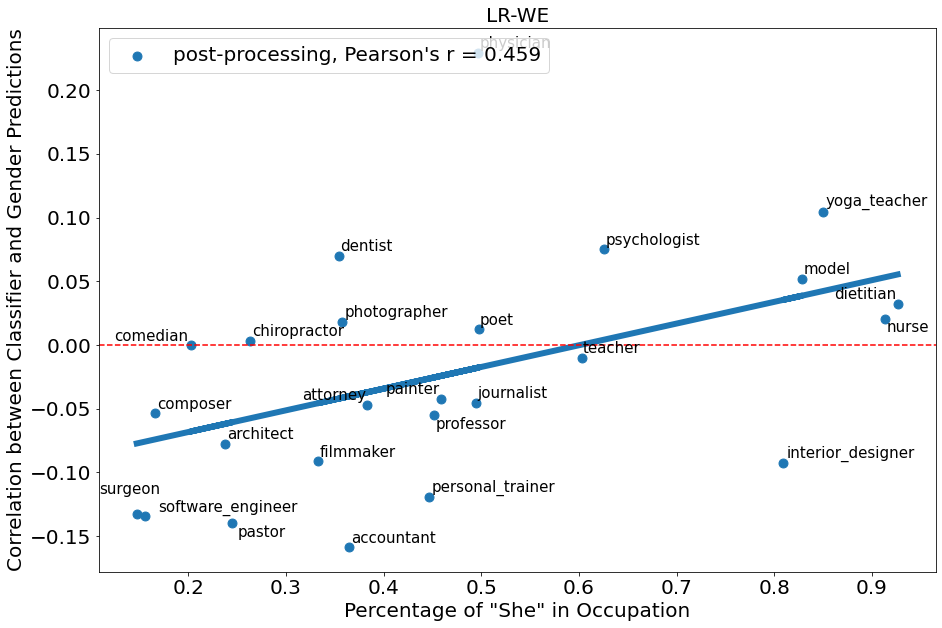

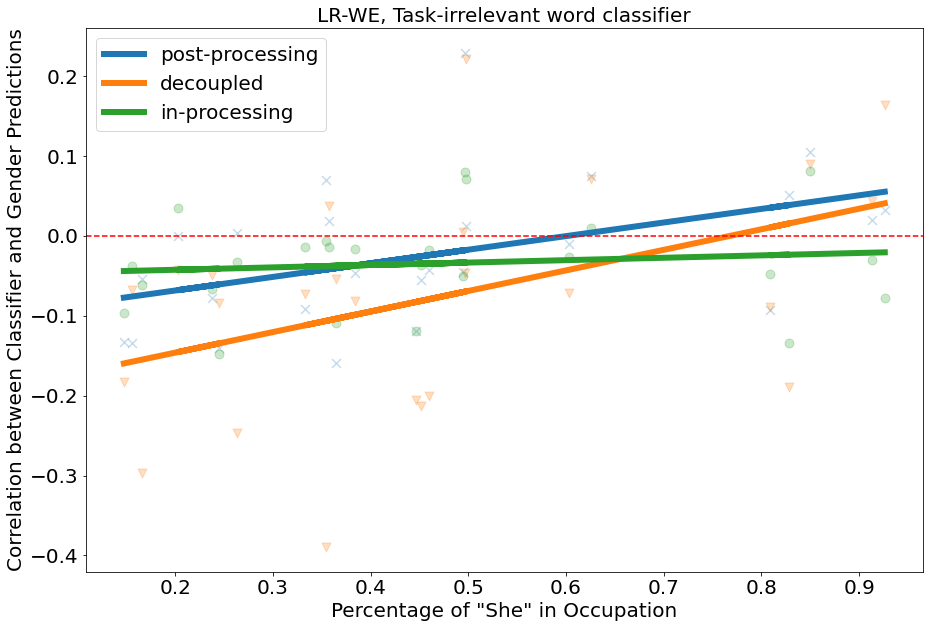

In [167]:

matplotlib.rcParams.update({'font.size': 20})


pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=80,label='post-processing, Pearson\'s r = %.3f'%(scipy.stats.pearsonr( f_frac,joint_corr)[0]))
plt.plot(xs, m*xs+ b,linewidth=6)

plt.legend(loc='upper left')

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = "Percentage of \"She\" in Occupation"
y_label = 'Correlation between Classifier and Gender Predictions'
texts = [plt.text(x,y,l,size=15) for x, y, l in zip(f_frac, joint_corr, occs)]
# adjust_text(texts)
xlabel(x_label,size = 20 )
ylabel(y_label, size=20)
# plt.ylim([-0.4, 0.4])
plt.title("LR-WE",fontsize=20)

plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=80,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label='post-processing')

m, b = np.polyfit(xs, np.array(decoupled_corr).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr,s=80,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label='decoupled')


m, b = np.polyfit(xs, np.array(tpr_corr).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr,s=80,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label='in-processing')
plt.legend(loc='upper left')


plt.axhline(y=0, color='r', linestyle='dashed')

# x_label = "% FEMALE in Occupation"
# y_label = 'Correlation between Classifier and Gender Probs for \"She\" Bios in Occupation'
# texts = [plt.text(x,y,l) for x, y, l in zip(f_frac, decoupled_corr, occs)]
# adjust_text(texts)
xlabel(x_label,size = 20 )
ylabel(y_label, size=20)
# plt.ylim([-0.4, 0.4])
plt.title("LR-WE, Task-irrelevant word classifier",fontsize=20)

Text(0.5, 1.0, 'LR-WE, Task-irrelevant word classifier')

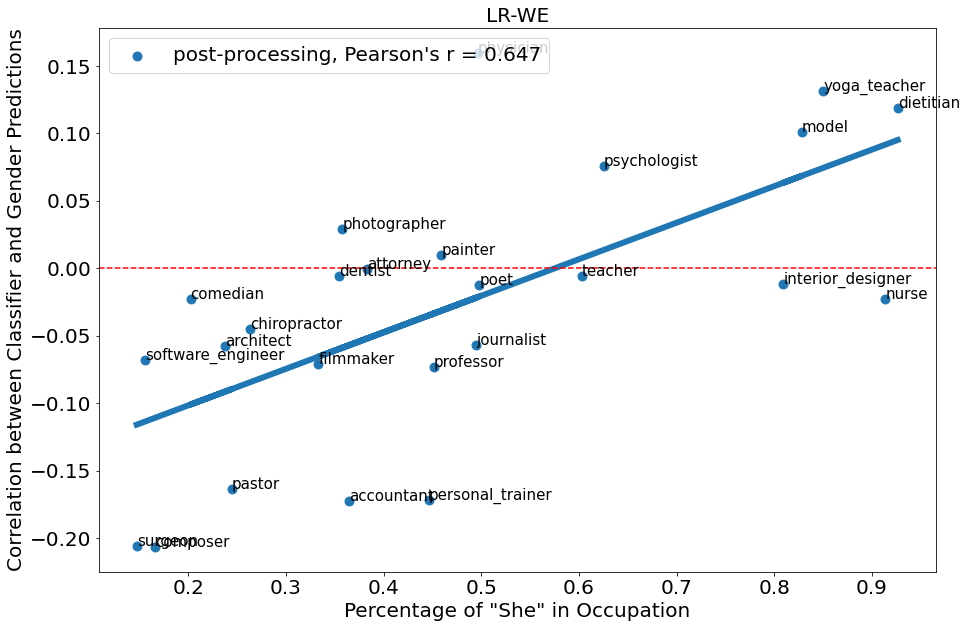

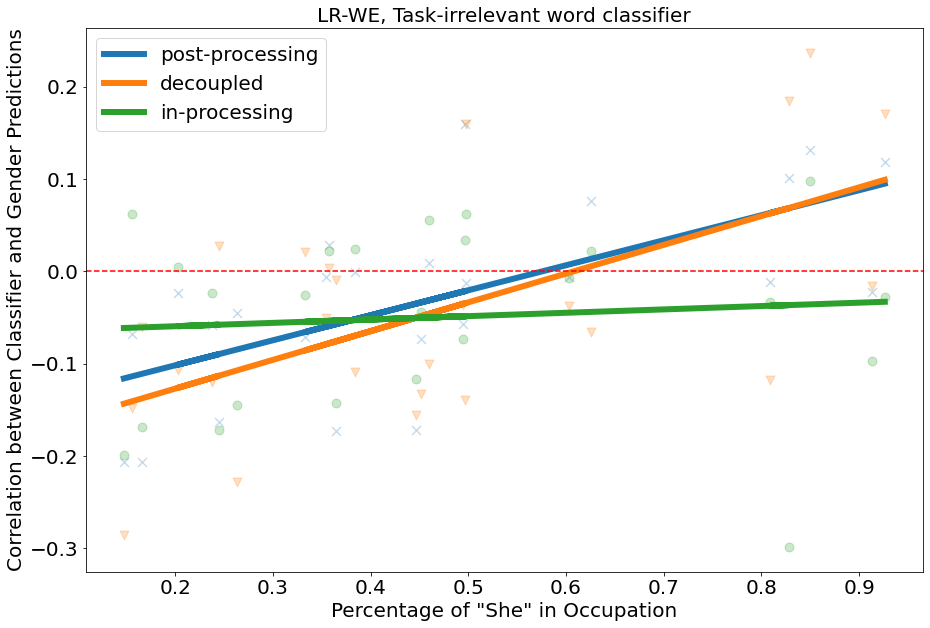

In [216]:

matplotlib.rcParams.update({'font.size': 20})


pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=80,label='post-processing, Pearson\'s r = %.3f'%(scipy.stats.pearsonr( f_frac,joint_corr)[0]))
plt.plot(xs, m*xs+ b,linewidth=6)

plt.legend(loc='upper left')

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = "Percentage of \"She\" in Occupation"
y_label = 'Correlation between Classifier and Gender Predictions'
texts = [plt.text(x,y,l,size=15) for x, y, l in zip(f_frac, joint_corr, occs)]
# adjust_text(texts)
xlabel(x_label,size = 20 )
ylabel(y_label, size=20)
# plt.ylim([-0.4, 0.4])
plt.title("LR-WE",fontsize=20)

plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=80,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label='post-processing')

m, b = np.polyfit(xs, np.array(decoupled_corr).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr,s=80,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label='decoupled')


m, b = np.polyfit(xs, np.array(tpr_corr).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr,s=80,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label='in-processing')
plt.legend(loc='upper left')


plt.axhline(y=0, color='r', linestyle='dashed')

# x_label = "% FEMALE in Occupation"
# y_label = 'Correlation between Classifier and Gender Probs for \"She\" Bios in Occupation'
# texts = [plt.text(x,y,l) for x, y, l in zip(f_frac, decoupled_corr, occs)]
# adjust_text(texts)
xlabel(x_label,size = 20 )
ylabel(y_label, size=20)
# plt.ylim([-0.4, 0.4])
plt.title("LR-WE, Task-irrelevant word classifier",fontsize=20)

In [46]:
thr = 6.6348966010212145

surgeon
software_engineer


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


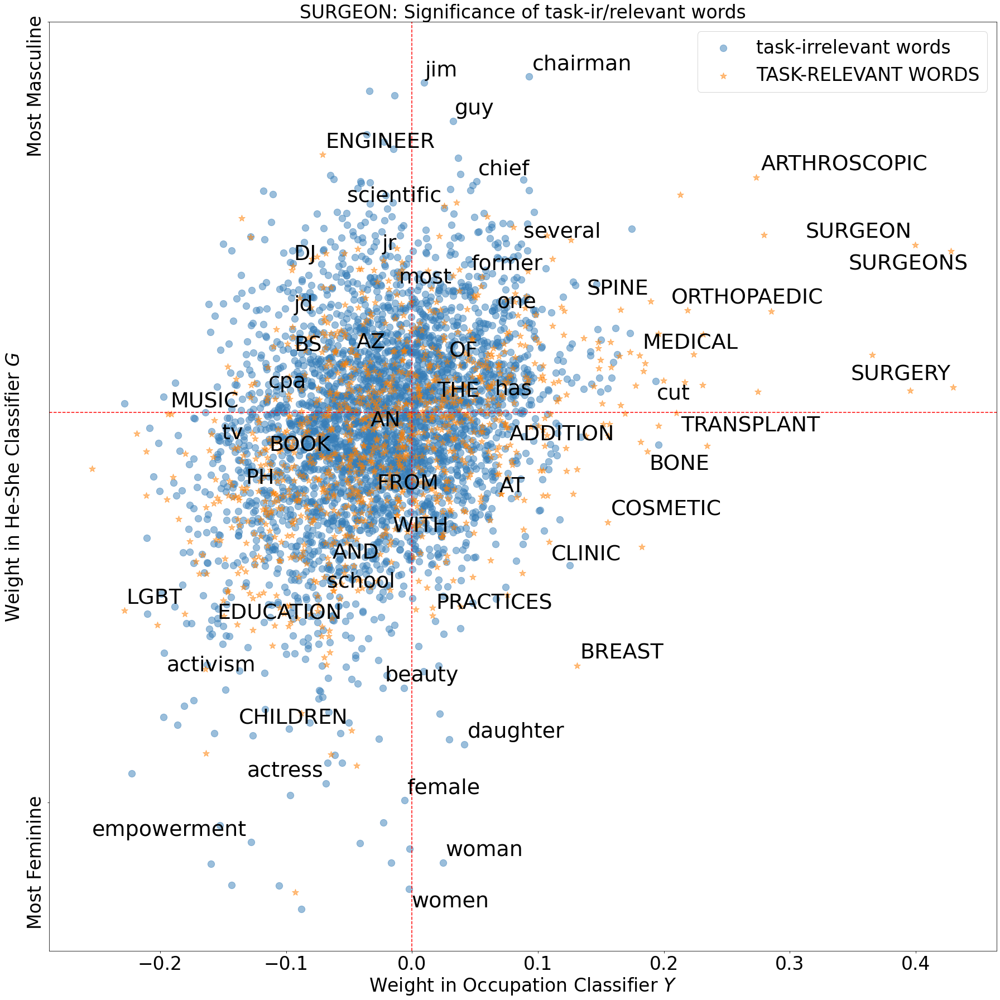

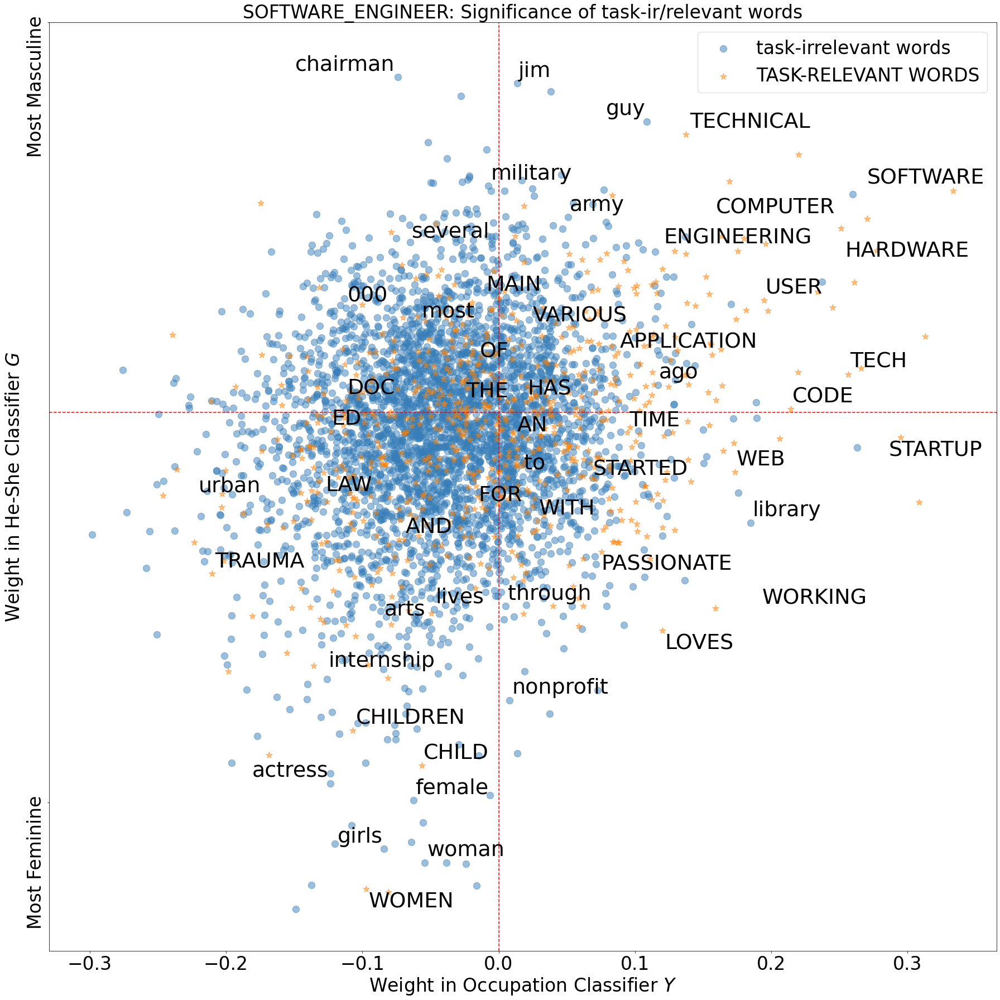

In [50]:
fontsizeval = 33

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


for target_occ in occs[0:2]:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_f'].coef_[0],w) for w in candwordvecs] 
    occ_dots_joint = [sim_emb(occ_classers[target_occ]['clf_bow_joint'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
#     colors = get_color_gradient(occ_dots_joint,gender_dots)
    
    xs = occ_dots_joint
    ys = gender_dots
    
    irrev_words_x = []
    irrev_words_y = []
    task_words_x = []
    task_words_y = []
    for i in range(len(labels)):
        if labels[i] in chi_vectorizers_or[target_occ][thr].vocabulary:
            irrev_words_x.append(xs[i])
            irrev_words_y.append(ys[i])
        else:
            task_words_x.append(xs[i])
            task_words_y.append(ys[i])
            labels[i] = labels[i].upper()
    plt.scatter(irrev_words_x,irrev_words_y,color=CB_color_cycle[0],alpha=0.5,s=150,label='task-irrelevant words')
    plt.scatter(task_words_x,task_words_y,color=CB_color_cycle[1],alpha=0.5,marker='*',s=150,label='Task-relevant words'.upper())
    plt.legend(fontsize=fontsizeval)

    plt.axhline(y=0, color='r', linestyle='dashed')
    plt.axvline(x=0, color='r', linestyle='dashed')
    my_xticks = ['Most Feminine','Most Masculine']
    y = np.array([-0.25,0.25])
    plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
    plt.xticks(fontsize=fontsizeval)
    plt.title(target_occ.upper() + ': Significance of task-ir/relevant words',fontsize=fontsizeval)
    xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
    ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
    xs,ys,ls= text_plot_words_locs(xs,ys,labels,2,width=30)
    # ylabel(y_label, size=20)
    texts = [plt.text(x,y,l,size=fontsizeval+5) for x, y, l in zip(xs, ys, ls)]
    adjust_text(texts)
    plt.tight_layout()
    plt.savefig('%s_taskirrev.pdf'%target_occ,dpi=1200,bbox_inches = 'tight', pad_inches = 0)

In [49]:
  CB_color_cycle = [(0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
(1.0, 0.4980392156862745, 0.0),
(0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
(0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
(0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
(0.596078431372549, 0.3058823529411765, 0.6392156862745098),
(0.6, 0.6, 0.6),
(0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
(0.8705882352941177, 0.8705882352941177, 0.0),]

surgeon


/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adam/Dropbox/WorkProjects/venv_main/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


software_engineer


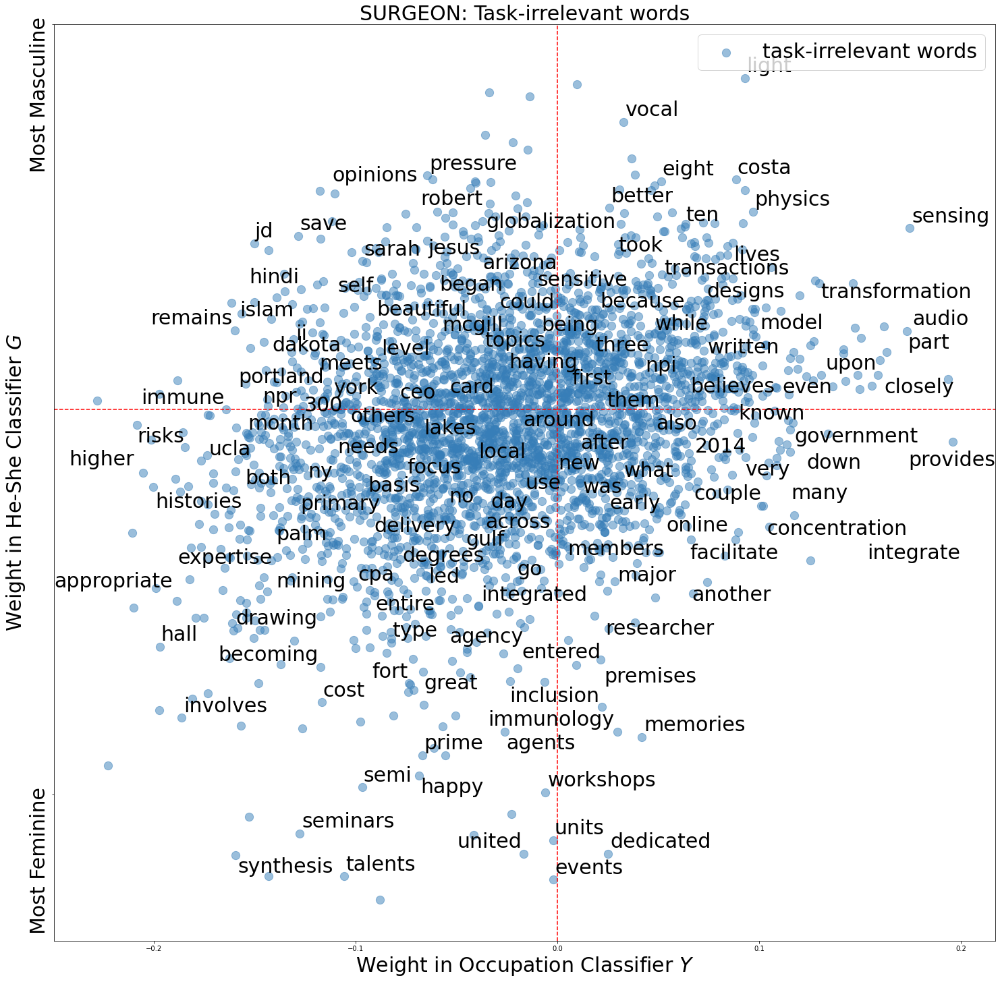

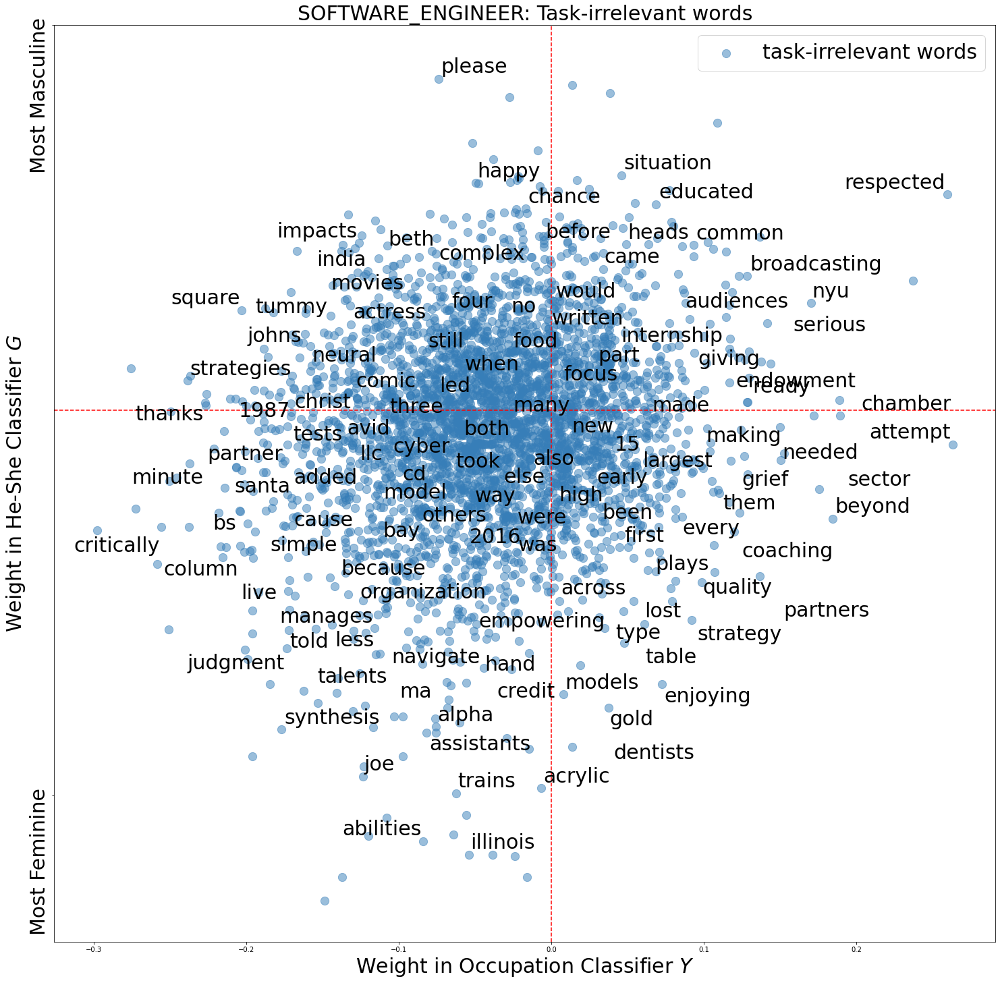

In [268]:


occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


for target_occ in occs[0:2]:
    plt.figure(figsize=(25,25))

    print(target_occ)
    se_bios = [p for p in bios_data_train if (p['gender']=='F') and (p['title']==target_occ)]
    all_se_bios = ""
    for s in se_bios:
        all_se_bios += s['bio']
    words_by_freq = dict(Counter(all_se_bios.split()).most_common())
    
    argsort_keys = sorted(range(len(words)), key=sort_helper,reverse=True)
    words_by_freq = words[argsort_keys]
    candwordvecs = []
    wordlist = []
    for k in words_by_freq:
        temp = word_vector_featurize(k, E)
        if type(temp) == np.ndarray:
            candwordvecs.append(temp)
            wordlist.append(k)
    gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
    occ_dots_f = [sim_emb(occ_classers[target_occ]['clf_bow_f'].coef_[0],w) for w in candwordvecs] 
    occ_dots_joint = [sim_emb(occ_classers[target_occ]['clf_bow_joint'].coef_[0],w) for w in candwordvecs] 
    
    labels = wordlist
#     colors = get_color_gradient(occ_dots_joint,gender_dots)
    
    xs = occ_dots_joint
    ys = gender_dots
    
    irrev_words_x = []
    irrev_words_y = []
    task_words_x = []
    task_words_y = []
    for i in range(len(labels)):
        if labels[i] in chi_vectorizers_or[target_occ][thr].vocabulary:
            irrev_words_x.append(xs[i])
            irrev_words_y.append(ys[i])
        else:
            task_words_x.append(xs[i])
            task_words_y.append(ys[i])
            labels[i] = labels[i].upper()
    plt.scatter(irrev_words_x,irrev_words_y,color=CB_color_cycle[0],alpha=0.5,s=150,label='task-irrelevant words')
#     plt.scatter(task_words_x,task_words_y,color=CB_color_cycle[1],alpha=0.5,marker='*',s=150,label='Task-relevant words'.upper())
    plt.legend(fontsize=fontsizeval)

    plt.axhline(y=0, color='r', linestyle='dashed')
    plt.axvline(x=0, color='r', linestyle='dashed')
    my_xticks = ['Most Feminine','Most Masculine']
    y = np.array([-0.25,0.25])
    plt.yticks(y,my_xticks,fontsize=fontsizeval,rotation=90)
    plt.title(target_occ.upper() + ': Task-irrelevant words',fontsize=fontsizeval)
    xlabel("Weight in Occupation Classifier $Y$",size = fontsizeval )
    ylabel("Weight in He-She Classifier $G$", size=fontsizeval)
#     xs,ys,ls= text_plot_words_locs(xs,ys,labels,2,width=50)
    # ylabel(y_label, size=20)
    
    xs,ys,ls= text_plot_words_locs(irrev_words_x,irrev_words_y,labels_irrev,2)
    texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(xs, ys, ls)]
    adjust_text(texts)
    
    
    
#     ylabel(y_label, size=20)
#     texts = [plt.text(x,y,l,size=17) for x, y, l in zip(xs, ys, ls)]
#     adjust_text(texts)

Populating the interactive namespace from numpy and matplotlib


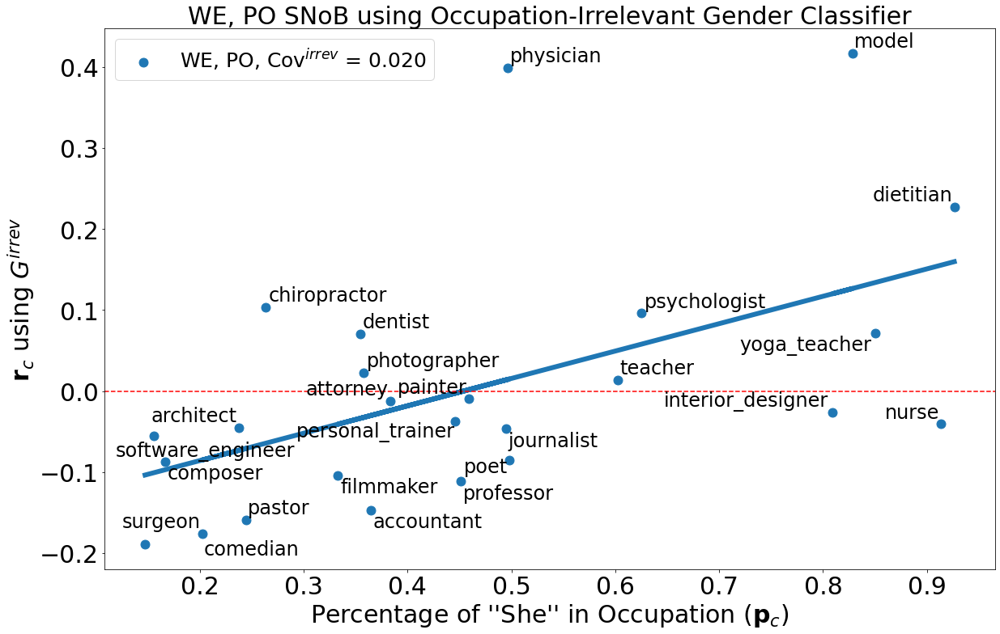

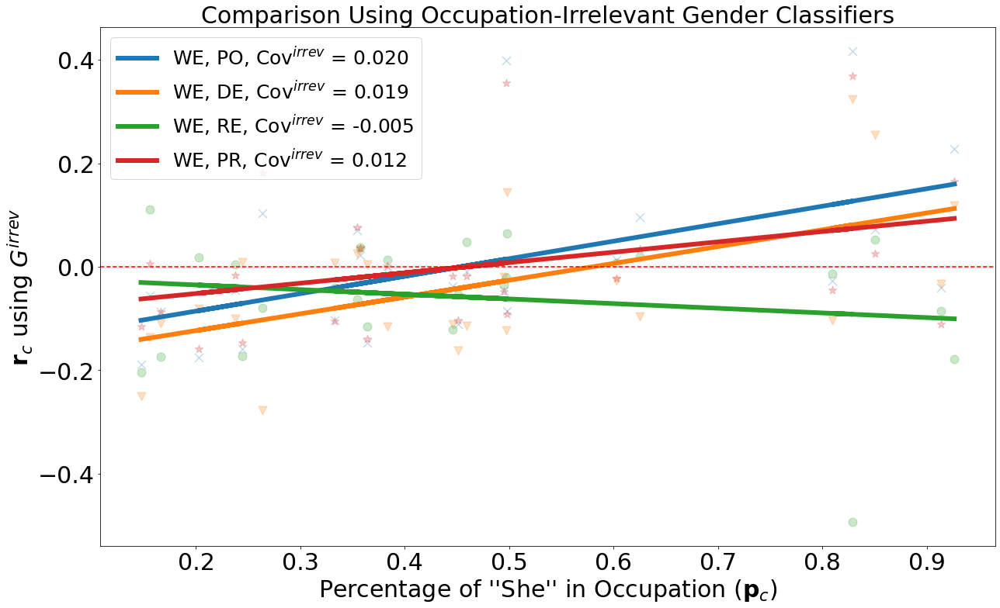

In [329]:
%pylab inline
fontsizeval = 30
from adjustText import adjust_text
import scipy
from scipy.stats import pearsonr
plt.rc('text', usetex=False)

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


f_frac = np.load('results/f_frac.npy')

pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=120,label='WE, PO, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,joint_corr)[0,1]))
plt.plot(xs, m*xs+ b,linewidth=6)

leg = plt.legend(loc='upper right',fontsize=fontsizeval-5)

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_c$)"
y_label = r'$\mathbf{r}_c$ using $G^{irrev}$'
texts = [plt.text(x,y,l,size=24) for x, y, l in zip(f_frac, joint_corr, occs)]

xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.45, 0.45])
plt.title("SNoB with Occupation-Irrelevant Gender Classifier",fontsize=fontsizeval)
plt.xticks(fontsize= fontsizeval)

plt.yticks(fontsize= fontsizeval)
plt.tight_layout()
adjust_text(texts)
plt.savefig('fig1_pearson_tight_irrev.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)
plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,joint_corr)[0,1]))

m, b = np.polyfit(xs, np.array(decoupled_corr).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,decoupled_corr)[0,1]))


m, b = np.polyfit(xs, np.array(tpr_corr).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,tpr_corr)[0,1]))

m, b = np.polyfit(xs, np.array(pr_corr).reshape(-1,), 1)
plt.scatter(f_frac,pr_corr,s=120,marker='*',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PR, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,pr_corr)[0,1]))

leg = plt.legend(loc='upper left',fontsize= fontsizeval-5)


plt.axhline(y=0, color='r', linestyle='dashed')

# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.45, 0.45])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison Using Occupation-Irrelevant Gender Classifiers",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight_irrev.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


Populating the interactive namespace from numpy and matplotlib


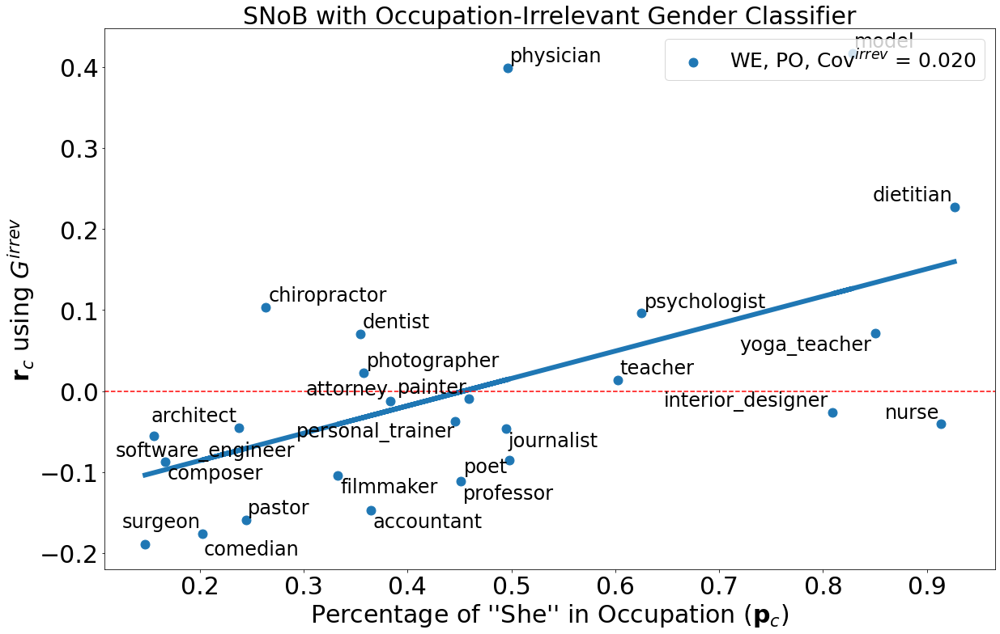

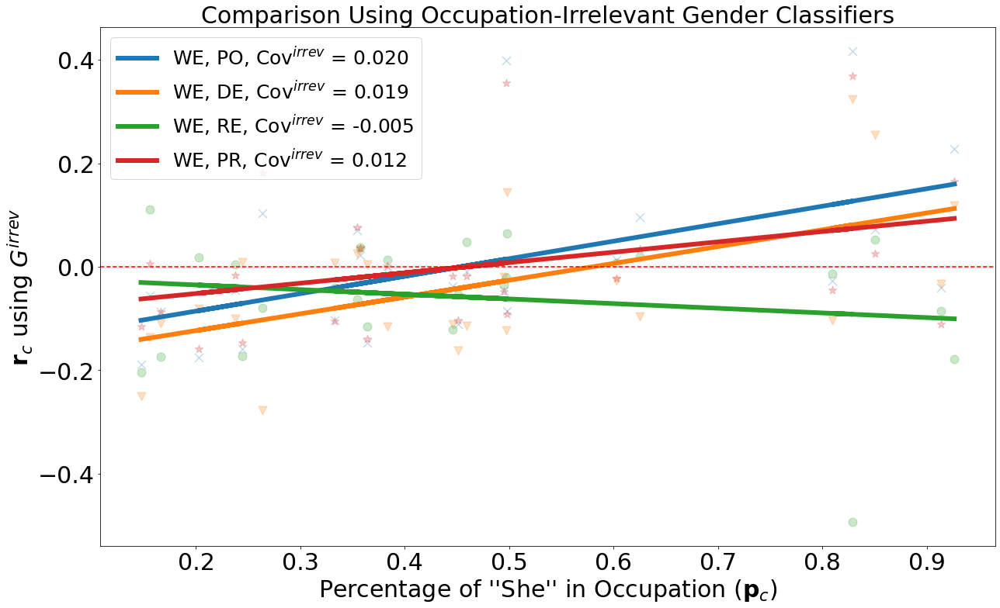

In [277]:
%pylab inline
fontsizeval = 30
from adjustText import adjust_text
import scipy
from scipy.stats import pearsonr
plt.rc('text', usetex=False)

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


f_frac = np.load('results/f_frac.npy')

pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=120,label='WE, PO, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,joint_corr)[0,1]))
plt.plot(xs, m*xs+ b,linewidth=6)

leg = plt.legend(loc='upper right',fontsize=fontsizeval-5)

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_c$)"
y_label = r'$\mathbf{r}_c$ using $G^{irrev}$'
texts = [plt.text(x,y,l,size=24) for x, y, l in zip(f_frac, joint_corr, occs)]

xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.45, 0.45])
plt.title("SNoB with Occupation-Irrelevant Gender Classifier",fontsize=fontsizeval)
plt.xticks(fontsize= fontsizeval)

plt.yticks(fontsize= fontsizeval)
plt.tight_layout()
adjust_text(texts)
plt.savefig('fig1_pearson_tight_irrev.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)
plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (18, 11)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,joint_corr)[0,1]))

m, b = np.polyfit(xs, np.array(decoupled_corr).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,decoupled_corr)[0,1]))


m, b = np.polyfit(xs, np.array(tpr_corr).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,tpr_corr)[0,1]))

m, b = np.polyfit(xs, np.array(pr_corr).reshape(-1,), 1)
plt.scatter(f_frac,pr_corr,s=120,marker='*',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PR, Cov$^{irrev}$ = %.3f'%(np.cov(f_frac,pr_corr)[0,1]))

leg = plt.legend(loc='upper left',fontsize= fontsizeval-5)


plt.axhline(y=0, color='r', linestyle='dashed')

# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.45, 0.45])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison Using Occupation-Irrelevant Gender Classifiers",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight_irrev.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


# CoCL Vs RMS

In [53]:
a = pkl.load(open('results/cocl_vs_rms_0to10.pkl','rb'))
rms_gaps = a['rms_gaps']
cocl_corrs = a['cocl_corrs']
accs = a['accs']

In [55]:
ind = 2
print(rms_gaps[ind])
print(cocl_corrs[ind])
print(accs[ind])

0.07448831546456014
SpearmanrResult(correlation=0.693076923076923, pvalue=0.00012273987658660733)
0.9426916352226096


In [447]:
b = pkl.load(open('results/cocl_vs_rms_10to20.pkl','rb'))
rms_gaps.extend(b['rms_gaps'][1:])
cocl_corrs.extend(b['cocl_corrs'][1:])
accs.extend(b['accs'][1:])

In [419]:
len(cocl_corrs)

11

In [420]:

pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(rms_gaps).reshape(-1,)

m, b = np.polyfit(xs, np.array(cocl_corrs).reshape(-1,), 1)
plt.scatter(rms_gaps,cocl_corrs,s=80)
plt.plot(xs, m*xs+ b,linewidth=6)


x_label = "RMS Gap"
y_label = 'Cov$(\mathbf{p}_c, \mathbf{r}_c)$'
texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(rms_gaps, cocl_corrs, range(11))]
# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.4, 0.4])
plt.title("CoCL with different values of $\lambda$",fontsize=fontsizeval)

TypeError: expected x and y to have same length

Text(0.5, 1.0, 'Tradeoff between Accuracy and RMS Gap for different values of $\\lambda$')

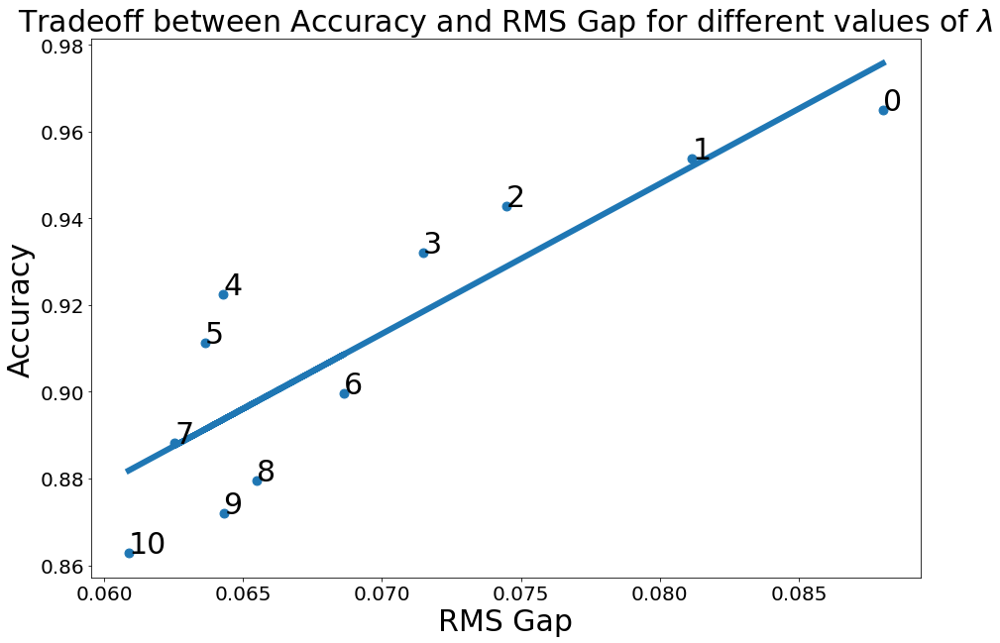

In [143]:

pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(rms_gaps).reshape(-1,)

m, b = np.polyfit(xs, np.array(accs).reshape(-1,), 1)
plt.scatter(rms_gaps,accs,s=80)
plt.plot(xs, m*xs+ b,linewidth=6)


x_label = "RMS Gap"
y_label = 'Accuracy'
texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(rms_gaps, accs, range(11))]
# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.4, 0.4])
plt.title("Tradeoff between Accuracy and RMS Gap for different values of $\lambda$",fontsize=fontsizeval)

In [421]:

pylab.rcParams['figure.figsize'] = (15, 10)
xs = np.array(cocl_corrs).reshape(-1,)

m, b = np.polyfit(xs, np.array(accs).reshape(-1,), 1)
plt.scatter(cocl_corrs,accs,s=80)
plt.plot(xs, m*xs+ b,linewidth=6)


x_label = 'Cov$(\mathbf{p}_c, \mathbf{r}_c)$'
y_label = 'Accuracy'
texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(cocl_corrs, accs, range(11))]
# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.4, 0.4])
plt.title("Tradeoff between Accuracy and SNoB for different values of $\lambda$",fontsize=fontsizeval)

TypeError: expected x and y to have same length

In [200]:
cocl_corrs

[0.018344032967879752,
 0.016414319131547915,
 0.015611933134147327,
 0.013760956205062552,
 0.013746548733581084,
 0.013478432548715159,
 0.013481380704122456,
 0.012869424209746304,
 0.01138385077313897,
 0.011590815201442494,
 0.011353006070759498]

In [401]:
np.array(cocl_corrs)[:,0].shape

(21,)

Text(0.5, 1.0, 'CoCL with different values of $\\lambda$')

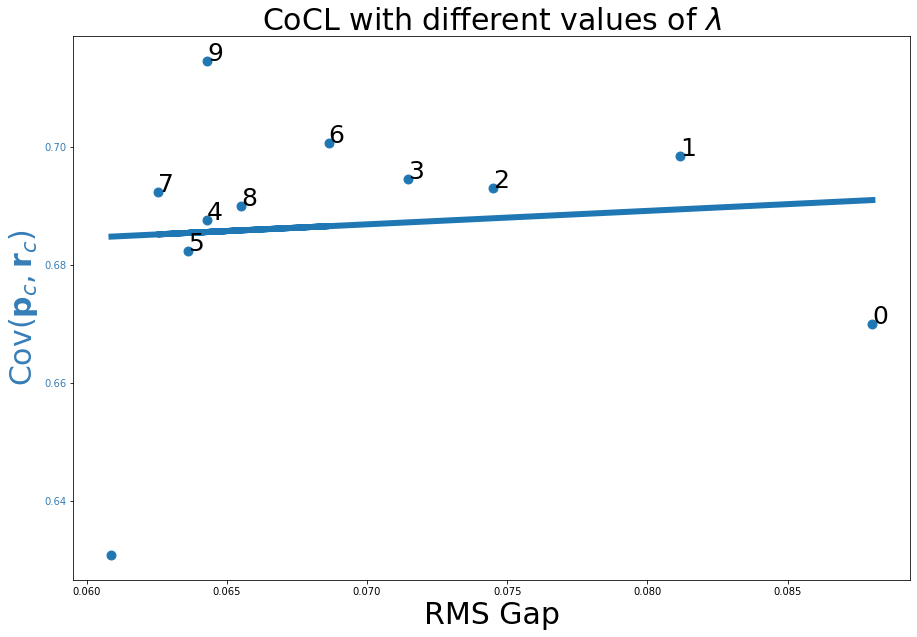

In [423]:

fig, ax1 = plt.subplots()

xs = np.array(rms_gaps).reshape(-1,)

m, b = np.polyfit(xs, np.array(cocl_corrs)[:,0], 1)
ax1.scatter(rms_gaps,np.array(cocl_corrs)[:,0],s=80)
ax1.plot(xs, m*xs+ b,linewidth=6)


x_label = "RMS Gap"
y_label = 'Cov$(\mathbf{p}_c, \mathbf{r}_c)$'
texts = [plt.text(x,y,l,size=fontsizeval-5) for x, y, l in zip(rms_gaps, np.array(cocl_corrs)[:,0], range(10))]
# adjust_text(texts)
ax1.set_xlabel(x_label,size = fontsizeval )
ax1.set_ylabel(y_label, size=fontsizeval,color='#377eb8')
ax1.tick_params(axis='y', labelcolor='#377eb8')
# plt.ylim([-0.4, 0.4])
plt.title("CoCL with different values of $\lambda$",fontsize=fontsizeval)


# ax2 = ax1.twinx() 

# m, b = np.polyfit(xs, np.array(accs).reshape(-1,), 1)
# ax2.scatter(rms_gaps,accs,s=80,color='#ff7f00')
# ax2.plot(xs, m*xs+ b,linewidth=6,color='#ff7f00')

# color = 'tab:blue'

# x_label = "RMS Gap"
# y_label = 'Accuracy'
# ax2.set_ylabel(y_label, size=fontsizeval,color='#ff7f00')
# ax2.tick_params(axis='y', labelcolor='#ff7f00')

# texts = [plt.text(x,y,l,size=fontsizeval-5) for x, y, l in zip(rms_gaps, accs, range(11))]
# # adjust_text(texts)

In [438]:
a = pkl.load(open('results/cocl_vs_rms.pkl','rb'))
rms_gaps = a['rms_gaps']
cocl_corrs = a['cocl_corrs']
accs = a['accs']



In [439]:
rms_gaps

[0.08802611376029401,
 0.08116503213647187,
 0.07448831546456014,
 0.07147748602200174,
 0.06428836800292043,
 0.06362456962510694,
 0.06863460059443106,
 0.06254332206956124,
 0.065500707130588,
 0.06430071902006552,
 0.06088724630743622,
 0.06048368317297279,
 0.05755980975829238,
 0.06031626360930368,
 0.05894779034918518,
 0.054974279370472834,
 0.04823414255693499,
 0.05086193014870233,
 0.05208566473492822,
 0.04771798866036053,
 0.03355133698625286]

In [436]:
np.shape(cocl_corrs)

(9, 2)

In [443]:
cocl_corrs = cocl_corrs[1:]
accs = accs[1:]
rms_gaps = rms_gaps[1:]

In [ ]:
cocl_co

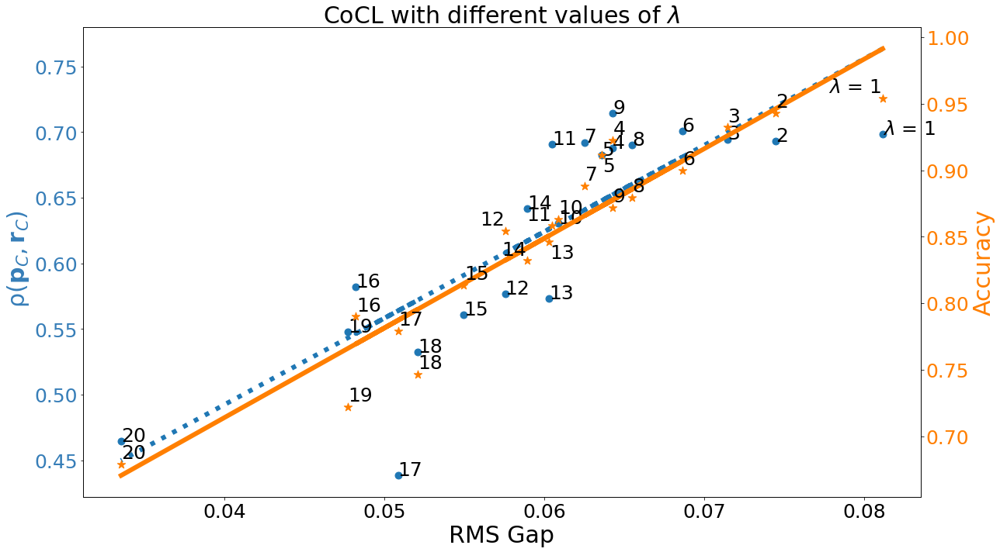

In [494]:

fig, ax1 = plt.subplots()

xs = np.array(rms_gaps).reshape(-1,)

m, b = np.polyfit(xs, np.array(cocl_corrs)[:,0].reshape(-1,), 1)
plt.xticks(size=fontsizeval-5)

ax1.scatter(rms_gaps, np.array(cocl_corrs)[:,0],s=80)
ax1.plot(xs, m*xs+ b,linewidth=6,linestyle='dotted')


x_label = "RMS Gap"
y_label = ' ρ$(\mathbf{p}_C, \mathbf{r}_C)$'
labels = list(range(1,21))
labels[0] = '$\lambda$ = 1'
texts = [plt.text(x,y,l,size=fontsizeval-5) for x, y, l in zip(rms_gaps, np.array(cocl_corrs)[:,0],labels)]
# adjust_text(texts)
ax1.set_xlabel(x_label,size = fontsizeval )
ax1.set_ylabel(y_label, size=fontsizeval,color='#377eb8')
plt.yticks(size=fontsizeval-5)

ax1.tick_params(axis='y', labelcolor='#377eb8')
# plt.ylim([-0.4, 0.4])
plt.title("CoCL with different values of $\lambda$",fontsize=fontsizeval)


ax2 = ax1.twinx() 

m, b = np.polyfit(xs, np.array(accs).reshape(-1,), 1)
ax2.scatter(rms_gaps,accs,s=120,color='#ff7f00',marker='*')
ax2.plot(xs, m*xs+ b,linewidth=6,color='#ff7f00')

color = 'tab:blue'

x_label = "RMS Gap"
y_label = 'Accuracy'
plt.yticks(size=fontsizeval-5)

ax2.set_ylabel(y_label, size=fontsizeval,color='#ff7f00')
ax2.tick_params(axis='y', labelcolor='#ff7f00')
plt.xticks(size=fontsizeval-5)

texts = [plt.text(x,y,l,size=fontsizeval-5) for x, y, l in zip(rms_gaps, accs, labels)]
adjust_text(texts)
plt.tight_layout()
plt.savefig('cocl_spearman_1.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


# ,marker='*'
# add lambda to caption

# New plots with spearman

In [42]:
(joint_corr_full,decoupled_corr_full,tpr_corr_full,pr_corr_full) = pkl.load(open('results/corrs_we_spearman.pkl','rb'))
from scipy.stats import spearmanr



Populating the interactive namespace from numpy and matplotlib


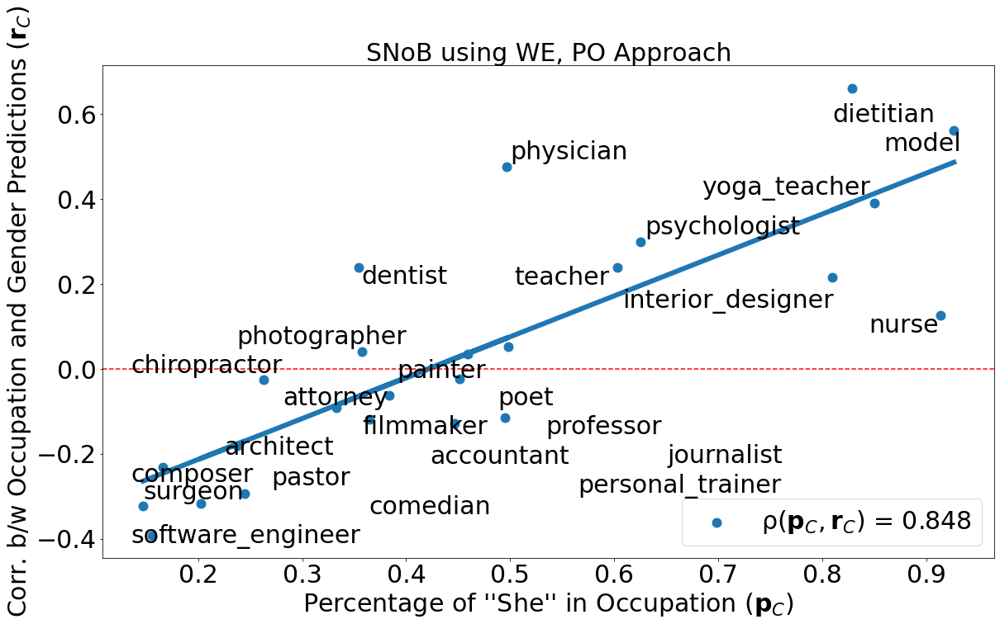

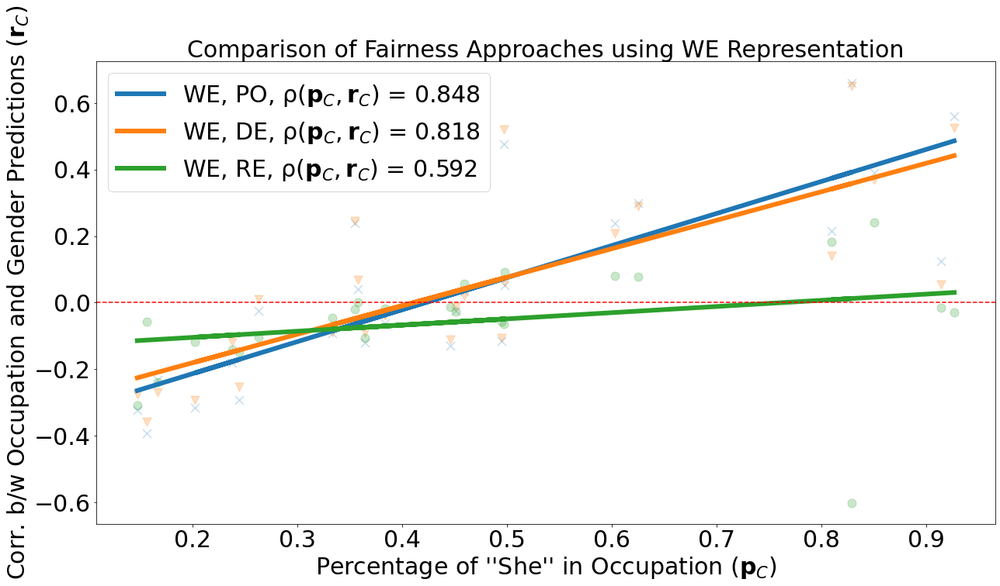

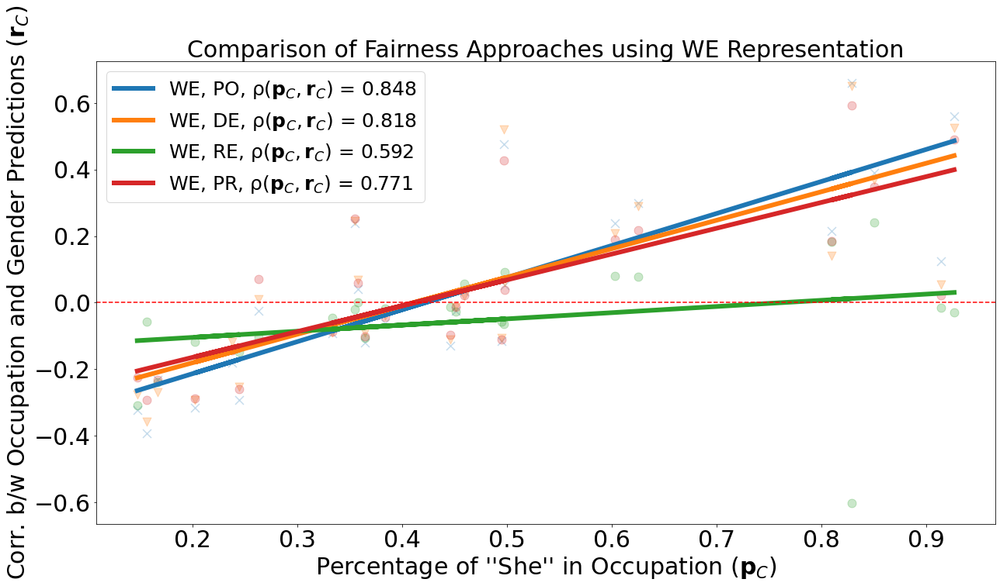

In [43]:
%pylab inline
fontsizeval = 30
from adjustText import adjust_text
import scipy
plt.rc('text', usetex=False)

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


f_frac = np.load('results/f_frac.npy')

pylab.rcParams['figure.figsize'] = (18, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,label='ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,joint_corr_full)[0]))
plt.plot(xs, m*xs+ b,linewidth=6)

leg = plt.legend(loc='lower right',fontsize=fontsizeval)

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_C$)"
y_label = r'Corr. b/w Occupation and Gender Predictions ($\mathbf{r}_C$)'
texts = [plt.text(x,y,l,size=30) for x, y, l in zip(f_frac, joint_corr_full, occs)]

xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.5, 0.5])
plt.title("SNoB using WE, PO Approach",fontsize=fontsizeval)
plt.xticks(fontsize= fontsizeval)

plt.yticks(fontsize= fontsizeval)
plt.tight_layout()
adjust_text(texts)
plt.savefig('fig1_pearson_tight.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)
plt.figure()
alph=0.25
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,joint_corr_full)[0]))

m, b = np.polyfit(xs, np.array(decoupled_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr_full,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,decoupled_corr_full)[0]))


m, b = np.polyfit(xs, np.array(tpr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,tpr_corr_full)[0]))
leg = plt.legend(loc='upper left',fontsize= fontsizeval)


plt.axhline(y=0, color='r', linestyle='dashed')

adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.5, 0.5])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison of Fairness Approaches using WE Representation",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    

plt.figure()
alph=0.25
xs = np.array(f_frac).reshape(-1,)

x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_C$)"
y_label = r'Corr. b/w Occupation and Gender Predictions ($\mathbf{r}_C$)'
m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,joint_corr_full)[0]))

m, b = np.polyfit(xs, np.array(decoupled_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr_full,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,decoupled_corr_full)[0]))


m, b = np.polyfit(xs, np.array(tpr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,tpr_corr_full)[0]))


m, b = np.polyfit(xs, np.array(pr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,pr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PR, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,pr_corr_full)[0]))

leg = plt.legend(loc='upper left',fontsize= fontsizeval-5)


plt.axhline(y=0, color='r', linestyle='dashed')

# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.5, 0.5])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison of Fairness Approaches using WE Representation",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight_4.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


Populating the interactive namespace from numpy and matplotlib


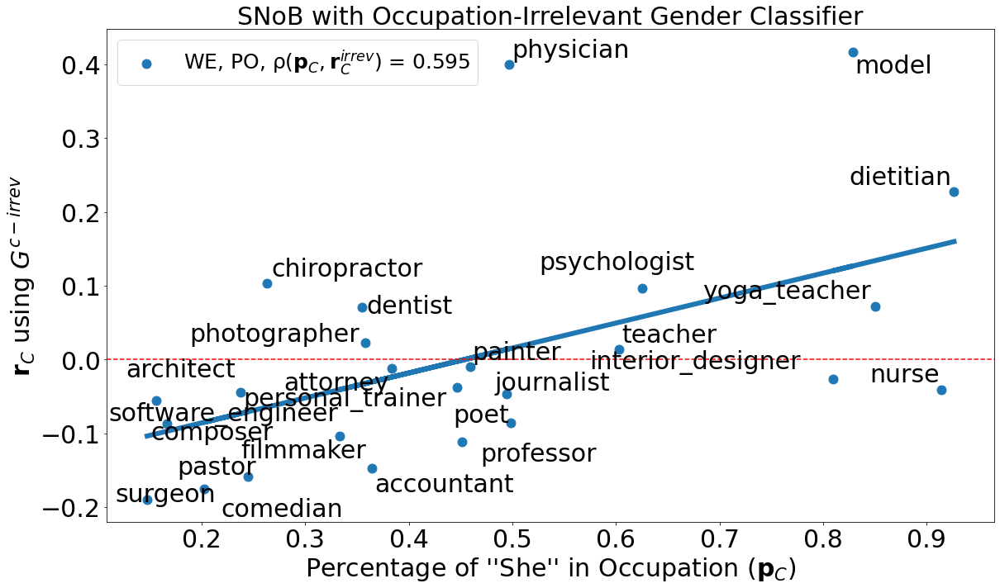

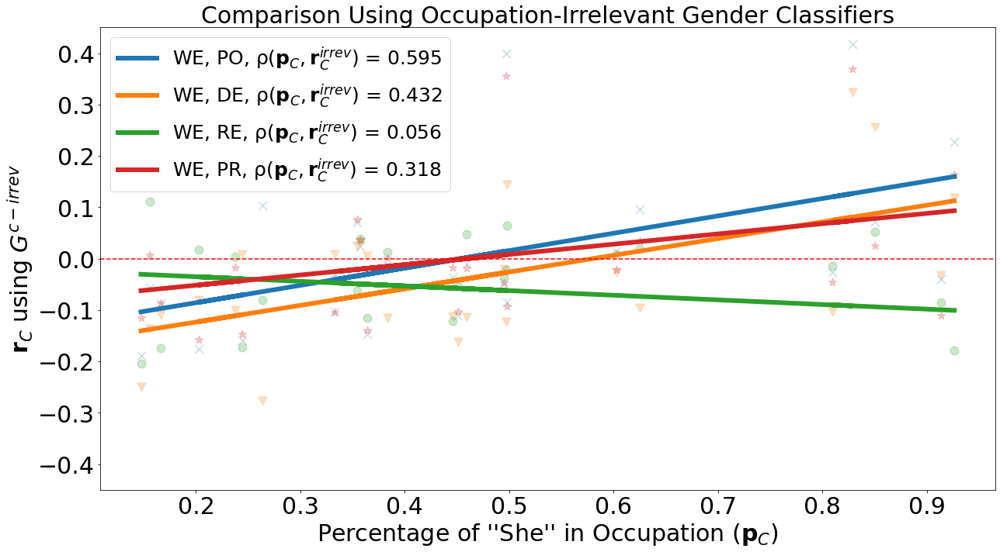

In [487]:
%pylab inline
fontsizeval = 30
from adjustText import adjust_text
import scipy
from scipy.stats import pearsonr
plt.rc('text', usetex=False)

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


f_frac = np.load('results/f_frac.npy')

pylab.rcParams['figure.figsize'] = (18, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=120,label='WE, PO, ρ$(\mathbf{p}_C, \mathbf{r}_C^{irrev})$ = %.3f'%(spearmanr(f_frac,joint_corr)[0]))
plt.plot(xs, m*xs+ b,linewidth=6)

leg = plt.legend(fontsize=fontsizeval-5)

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_C$)"
y_label = r'$\mathbf{r}_C$ using $G^{c-irrev}$'
texts = [plt.text(x,y,l,size=fontsizeval) for x, y, l in zip(f_frac, joint_corr, occs)]

xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.45, 0.45])
plt.title("SNoB with Occupation-Irrelevant Gender Classifier",fontsize=fontsizeval)
plt.xticks(fontsize= fontsizeval)

plt.yticks(fontsize= fontsizeval)
plt.tight_layout()
adjust_text(texts)
plt.savefig('fig1_pearson_tight_irrev.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)
plt.figure()
alph=0.25
pylab.rcParams['figure.figsize'] = (18, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PO, ρ$(\mathbf{p}_C, \mathbf{r}_C^{irrev})$ = %.3f'%(spearmanr(f_frac,joint_corr)[0]))

m, b = np.polyfit(xs, np.array(decoupled_corr).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, DE, ρ$(\mathbf{p}_C, \mathbf{r}_C^{irrev})$ = %.3f'%(spearmanr(f_frac,decoupled_corr)[0]))


m, b = np.polyfit(xs, np.array(tpr_corr).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, RE, ρ$(\mathbf{p}_C, \mathbf{r}_C^{irrev})$ = %.3f'%(spearmanr(f_frac,tpr_corr)[0]))

m, b = np.polyfit(xs, np.array(pr_corr).reshape(-1,), 1)
plt.scatter(f_frac,pr_corr,s=120,marker='*',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'WE, PR, ρ$(\mathbf{p}_C, \mathbf{r}_C^{irrev})$ = %.3f'%(spearmanr(f_frac,pr_corr)[0]))

leg = plt.legend(loc='upper left',fontsize= fontsizeval-5)


plt.axhline(y=0, color='r', linestyle='dashed')

# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
plt.ylim([-0.45, 0.45])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison Using Occupation-Irrelevant Gender Classifiers",fontsize=fontsizeval)

plt.tight_layout()

plt.savefig('fig2_pearson_tight_irrev_4.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


In [297]:
print(np.cov(f_frac,joint_corr)[0,1])
print(np.cov(f_frac,decoupled_corr)[0,1])
print(np.cov(f_frac,tpr_corr)[0,1])
print(np.cov(f_frac,pr_corr)[0,1])



0.019923948999436534
0.01914836533771833
-0.0053143809217658915
0.011777375957441934


In [345]:

print(spearmanr(f_frac,joint_corr_full[:25])[0])
print(spearmanr(f_frac,decoupled_corr_full[:25])[0])
print(spearmanr(f_frac,tpr_corr_full[:25])[0])

0.8484615384615384
0.8176923076923077
0.5923076923076923


In [416]:
print(spearmanr(f_frac,pr_corr_full[:25]))
print(spearmanr(f_frac,joint_corr_full[:25]))
print(spearmanr(f_frac,decoupled_corr_full[:25]))
print(spearmanr(f_frac,tpr_corr_full[:25]))

SpearmanrResult(correlation=0.7707692307692308, pvalue=6.5347630804877135e-06)
SpearmanrResult(correlation=0.8484615384615384, pvalue=8.424100542796248e-08)
SpearmanrResult(correlation=0.8176923076923077, pvalue=6.015321017396297e-07)
SpearmanrResult(correlation=0.5923076923076923, pvalue=0.0018114076181762059)


In [415]:
print(spearmanr(f_frac,pr_corr[:25]))
print(spearmanr(f_frac,joint_corr[:25]))
print(spearmanr(f_frac,decoupled_corr[:25]))
print(spearmanr(f_frac,tpr_corr[:25]))

SpearmanrResult(correlation=0.31846153846153846, pvalue=0.12078187516894845)
SpearmanrResult(correlation=0.5953846153846154, pvalue=0.0016902943707928163)
SpearmanrResult(correlation=0.4323076923076923, pvalue=0.03091049740592285)
SpearmanrResult(correlation=0.05615384615384616, pvalue=0.7897732549280512)


In [376]:
from scipy.stats import pearsonr
print(pearsonr(f_frac,joint_corr[:25])[0])
print(pearsonr(f_frac,decoupled_corr[:25])[0])
print(pearsonr(f_frac,tpr_corr[:25])[0])

0.5286036152754561
0.5698263660376036
-0.17723259870350505


In [351]:
np.where(abs(f_frac)<0.25)


(array([0, 1, 2, 3, 4, 5]),)

In [350]:
f_frac

array([0.14726696, 0.15604713, 0.16632078, 0.24457594, 0.20236686,
       0.23777486, 0.2632234 , 0.36433196, 0.38350232, 0.33301708,
       0.49677629, 0.35467537, 0.35764577, 0.45133067, 0.45919244,
       0.49458514, 0.49798626, 0.44611819, 0.60278603, 0.62529316,
       0.82843246, 0.8093076 , 0.85014985, 0.91377949, 0.92639063])

In [357]:
imbalanced_inds  = np.where(abs(f_frac-0.5)>0.25)[0]

In [358]:
imbalanced_inds

array([ 0,  1,  2,  3,  4,  5, 20, 21, 22, 23, 24])

In [378]:
def imb_pearsonr(l):
#     print("Pearson's r")
    print(scipy.stats.pearsonr(f_frac[imbalanced_inds],np.array(l)[imbalanced_inds])[0])
    
def imb_cov(l):
#     print("Covariance")
    print(np.cov(f_frac[imbalanced_inds],np.array(l)[imbalanced_inds])[0,1]) 
    
def imb_spear(l):
#     print("Spearman's r")
    print(scipy.stats.spearmanr(f_frac[imbalanced_inds],np.array(l)[imbalanced_inds])[0])
# print(pearsonr(f_frac,np.array(joint_corr_full)[imbalanced_inds])[0])
# print(pearsonr(f_frac,decoupled_corr_full[imbalanced_inds])[0])
# print(pearsonr(f_frac,tpr_corr_full[imbalanced_inds])[0])

In [379]:

imb_pearsonr(joint_corr_full)
imb_pearsonr(decoupled_corr_full)
imb_pearsonr(tpr_corr_full)
imb_pearsonr(pr_corr_full)


imb_spear(joint_corr_full)
imb_spear(decoupled_corr_full)
imb_spear(tpr_corr_full)

imb_cov(joint_corr_full)
imb_cov(decoupled_corr_full)
imb_cov(tpr_corr_full)

0.9162623277972329
0.8825574293304743
0.2961420433541055
0.8825647261809557
0.8545454545454546
0.8545454545454546
0.5181818181818182
0.125468242189707
0.11254419433947763
0.02408050638789027


In [380]:

imb_pearsonr(joint_corr)
imb_pearsonr(decoupled_corr)
imb_pearsonr(tpr_corr)
imb_pearsonr(pr_corr)

imb_spear(joint_corr)
imb_spear(decoupled_corr)
imb_spear(tpr_corr)

imb_cov(joint_corr)
imb_cov(decoupled_corr)
imb_cov(tpr_corr)

0.6970194586828056
0.6796897758344475
-0.219839224804174
0.5353025637687963
0.8000000000000002
0.8181818181818182
-0.1272727272727273
0.04537539602543369
0.0419954091675674
-0.013096091239296405


Populating the interactive namespace from numpy and matplotlib


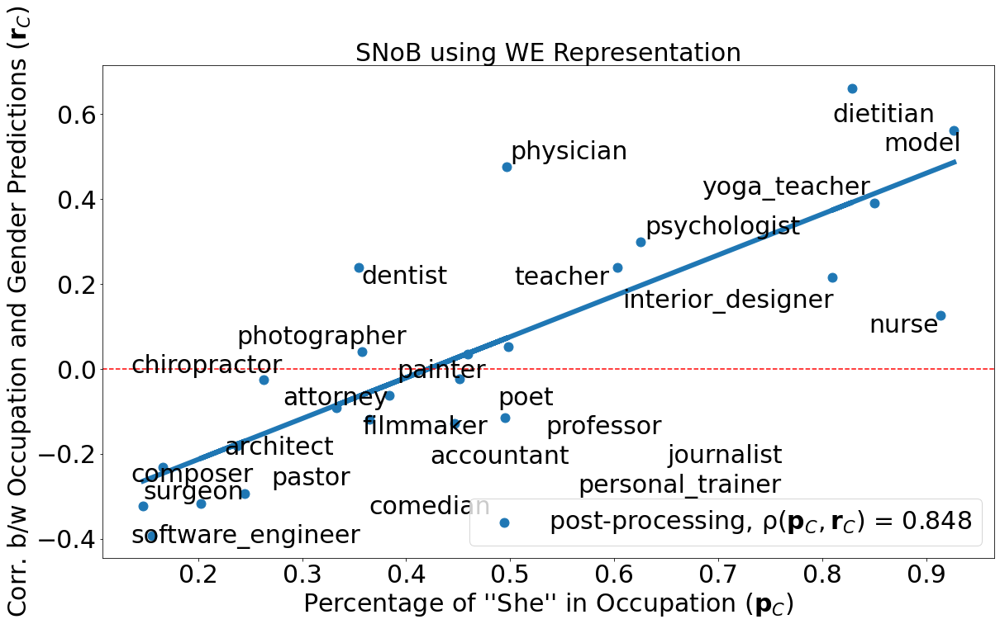

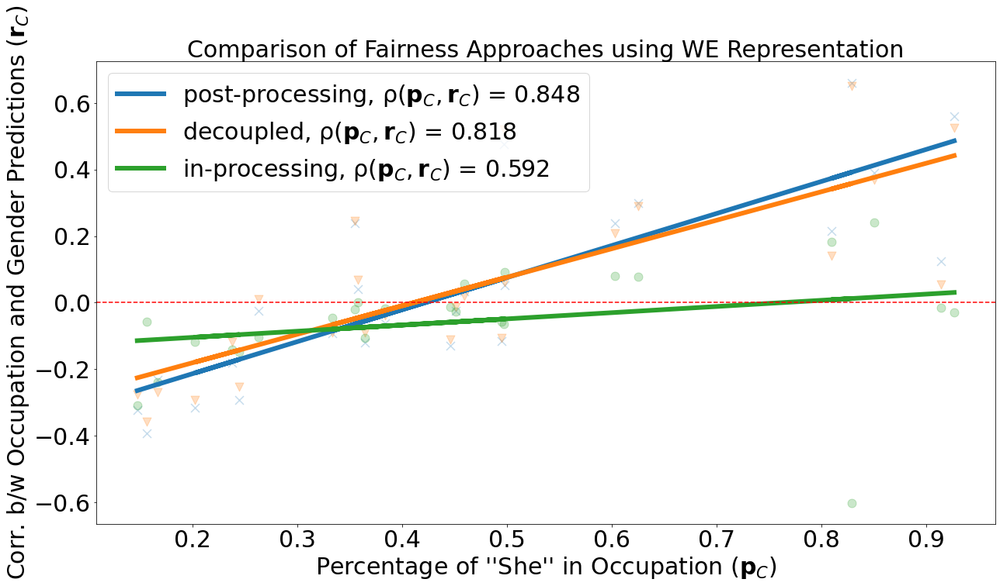

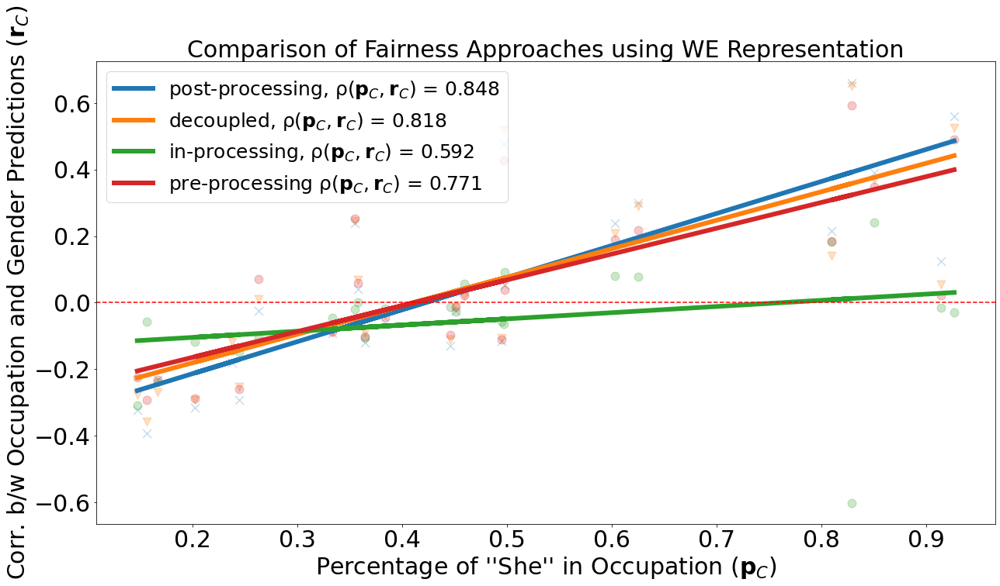

In [486]:
%pylab inline
fontsizeval = 30
from adjustText import adjust_text
import scipy
plt.rc('text', usetex=False)

occs = ["surgeon", "software_engineer", "composer", "pastor", "comedian", "architect", "chiropractor", "accountant", "attorney", "filmmaker", "physician", "dentist", "photographer", "professor", "painter", "journalist", "poet", "personal_trainer", "teacher", "psychologist",  "model", "interior_designer", "yoga_teacher", "nurse", "dietitian"]


f_frac = np.load('results/f_frac.npy')

pylab.rcParams['figure.figsize'] = (18, 10)
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,label='post-processing, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,joint_corr_full)[0]))
plt.plot(xs, m*xs+ b,linewidth=6)

leg = plt.legend(loc='lower right',fontsize=fontsizeval)

plt.axhline(y=0, color='r', linestyle='dashed')


x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_C$)"
y_label = r'Corr. b/w Occupation and Gender Predictions ($\mathbf{r}_C$)'
texts = [plt.text(x,y,l,size=30) for x, y, l in zip(f_frac, joint_corr_full, occs)]

xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.5, 0.5])
plt.title("SNoB using WE Representation",fontsize=fontsizeval)
plt.xticks(fontsize= fontsizeval)

plt.yticks(fontsize= fontsizeval)
plt.tight_layout()
adjust_text(texts)
# plt.savefig('fig1_pearson_tight.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)
plt.figure()
alph=0.25
xs = np.array(f_frac).reshape(-1,)

m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'post-processing, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,joint_corr_full)[0]))

m, b = np.polyfit(xs, np.array(decoupled_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr_full,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'decoupled, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,decoupled_corr_full)[0]))


m, b = np.polyfit(xs, np.array(tpr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'in-processing, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,tpr_corr_full)[0]))
leg = plt.legend(loc='upper left',fontsize= fontsizeval)


plt.axhline(y=0, color='r', linestyle='dashed')

adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.5, 0.5])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison of Fairness Approaches using WE Representation",fontsize=fontsizeval)

plt.tight_layout()

# plt.savefig('fig2_pearson_tight.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    

plt.figure()
alph=0.25
xs = np.array(f_frac).reshape(-1,)

x_label = r"Percentage of ''She'' in Occupation ($\mathbf{p}_C$)"
y_label = r'Corr. b/w Occupation and Gender Predictions ($\mathbf{r}_C$)'
m, b = np.polyfit(xs, np.array(joint_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,joint_corr_full,s=120,marker='x',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'post-processing, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,joint_corr_full)[0]))

m, b = np.polyfit(xs, np.array(decoupled_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,decoupled_corr_full,s=120,marker='v',alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'decoupled, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,decoupled_corr_full)[0]))


m, b = np.polyfit(xs, np.array(tpr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,tpr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'in-processing, ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,tpr_corr_full)[0]))


m, b = np.polyfit(xs, np.array(pr_corr_full).reshape(-1,), 1)
plt.scatter(f_frac,pr_corr_full,s=120,alpha=alph)
plt.plot(xs, m*xs+ b,linewidth=6,label=r'pre-processing ρ$(\mathbf{p}_C, \mathbf{r}_C)$ = %.3f'%(spearmanr(f_frac,pr_corr_full)[0]))

leg = plt.legend(loc='upper left',fontsize= fontsizeval-5)


plt.axhline(y=0, color='r', linestyle='dashed')

# adjust_text(texts)
xlabel(x_label,size = fontsizeval )
ylabel(y_label, size=fontsizeval)
# plt.ylim([-0.5, 0.5])
plt.xticks(fontsize= fontsizeval)
plt.yticks(fontsize= fontsizeval)

plt.title("Comparison of Fairness Approaches using WE Representation",fontsize=fontsizeval)

plt.tight_layout()

# plt.savefig('fig2_pearson_tight_4.pdf',dpi=1200,bbox_inches = 'tight', pad_inches = 0)    


In [471]:
## nonbinary
# get cov with task-irrelevant classifiers - OR, SPEARMAN
nb_bios = pd.read_pickle('results/nb_prof.pkl')
nb_bios_list = list(nb_bios['bio'])

thr = critical

joint_corr = []
decoupled_corr = []
tpr_corr = []
pr_corr = []
for target_occ in ['professor']:
    
    
    cand_women = np.array([p for p in nb_bios_list])
    
    irrev_corr_X_test = [word_vector_featurize_occ(p.lower(), target_occ, E) for i,p in enumerate(cand_women)]
    
    
    test_inds = []
    for i,p in enumerate(irrev_corr_X_test):
        if isinstance(p, np.ndarray):
            test_inds.append(i)
            
        
    irrev_corr_X_test_new = [irrev_corr_X_test[i] for i,p in enumerate(cand_women) if i in test_inds]
    
    
    
    
    
    gender_probs = chi_gender_classers_or[target_occ][thr].predict_proba(irrev_corr_X_test_new)[:,0]
    cand_women_X_full =  [word_vector_featurize(p) for p in cand_women[test_inds]]
    occ_probs = occ_classers[target_occ]['clf_bow_joint'].predict_proba(cand_women_X_full)[:,1]
    occ_probs_pr = occ_classers[target_occ]['clf_bow_joint_sampleweights'].predict_proba(cand_women_X_full)[:,1]
    
    cand_women_inds = np.array([i for i,p in enumerate(bios_data_test) if p["title"]==target_occ and p['gender']=='F'])
    cand_women_inds = cand_women_inds[test_inds]
    
    corr = spearmanr(occ_probs,gender_probs)
    joint_corr.append(corr)
    
    corr = spearmanr(occ_probs_pr,gender_probs)
    pr_corr.append(corr)
    
    occ_probs = occ_classers[target_occ]['clf_bow_f'].predict_proba(irrev_corr_X_test_new)[:,1]
    corr = spearmanr(occ_probs,gender_probs)
    decoupled_corr.append(corr)
#     decoupled_cov.append(cov)

#     occ_probs =  y_preds_tpr[target_occ][cand_women_inds][:,1]
#     corr = spearmanr(occ_probs,gender_probs)[0]
#     tpr_corr.append(corr)

# print(spearmanr(f_frac,joint_corr))
# print(spearmanr(f_frac,decoupled_corr))
# # print(spearmanr(f_frac,tpr_corr))
# print(spearmanr(f_frac,pr_corr))



In [472]:
joint_corr

[SpearmanrResult(correlation=-0.0051964926417214915, pvalue=0.9821646276753117)]

In [473]:
pr_corr

[SpearmanrResult(correlation=-0.08054563594668311, pvalue=0.7285390672683167)]

In [474]:
decoupled_corr

[SpearmanrResult(correlation=-0.12280701754385964, pvalue=0.5958854514253036)]

In [476]:

wordlist = []
for k in words_by_freq:
    temp = word_vector_featurize(k, E)
    if type(temp) == np.ndarray:
        candwordvecs.append(temp)
        wordlist.append(k)
gender_dots = [sim_emb(balanced_gender_clf.coef_[0],w) for w in candwordvecs] 
occ_dots_joint = [sim_emb(occ_classers['software_engineer']['clf_bow_joint'].coef_[0],w) for w in candwordvecs] 

In [478]:
np.where(np.array(wordlist)=='computer')

(array([36]),)

In [480]:
gender_dots[36]

0.12425725532766767